# Modeling for the white light weighted spectrum from MUSE and the spectra from MAGE

In [1]:
import numpy as np
import musetools.util as u
import musetools.io as io
from astropy.table import Table
from astropy.io import ascii
import matplotlib.pyplot as plt
from astropy.wcs import WCS
from astropy import units as ut
from astropy.coordinates import SkyCoord 
from decimal import Decimal
import matplotlib as mpl
from astropy.io import fits
from astropy.io import ascii
from astropy.convolution import convolve, Gaussian1DKernel
import matplotlib.gridspec as gridspec
import importlib
importlib.reload(u)


#### Modifying Matplotlib parameters
mpl.rcParams.update(mpl.rcParamsDefault)
mpl.rc('text',usetex=True)
XSMALL_SIZE = 10
SMALL_SIZE = 12
MEDIUM_SIZE = 14
LARGE_SIZE = 16
XLARGE_SIZE = 18
XXLARGE_SIZE = 24

plt.rc('font',size=SMALL_SIZE)
plt.rc('axes',titlesize=XLARGE_SIZE)
plt.rc('axes',labelsize=LARGE_SIZE)
plt.rc('axes',labelweight=700)
plt.rc('axes',titleweight=700)
plt.rc('xtick',labelsize=MEDIUM_SIZE)
plt.rc('ytick',labelsize=MEDIUM_SIZE)
plt.rc('legend',fontsize=XSMALL_SIZE)
plt.rc('figure',titlesize=XXLARGE_SIZE)

mpl.rcParams['font.family'] = 'serif'
mpl.rcParams['font.serif'] = 'Times'
mpl.rcParams['font.monospace'] = 'Ubuntu mono'

from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

## Defining the Fe II Model:

In [72]:
from copy import deepcopy
def tau_lambda_fn(wrest, lam_cen, f0, lam_out, N_out, N_sys, b_D_out, b_D_sys):
    """
    Given inputs:
    wrest: rest-frame wavelength array
    lam_cen: central rest-frame wavelength of the transition
    f0: oscillator strength of the transition

    Free parameters:
    lam_out: the central wavelength of the gaussian descrbing the optical depth of the outflow component
    N_out: Column density of the outflowing component
    N_sys: Column density of the systemic component
    b_D_out: Doppler velocity width for the outflowing component
    b_D_sys: Doppler velocity width for the systemic component

    Outputs:
    tau_out: optical depth of the outflowing component
    tau_sys: optical depth of the systemic component
    """
    c = 299792.458  # Speed of light in km/s

    tau_out = (1.497e-15 * lam_cen * f0) * (N_out/ b_D_out) * np.exp(- ( (wrest - lam_out) / (lam_out* (b_D_out/c) ) )**2. ) * np.piecewise(wrest,[wrest < lam_cen, wrest >= lam_cen], [1., 0.]) # tau for the Outflow at 2586
    tau_sys = (1.497e-15 * lam_cen * f0) * (N_sys/ b_D_sys) * np.exp(- ( (wrest - lam_cen) / (lam_cen* (b_D_sys/c) ) )**2. )           # tau for the Systemic at 2586
    return tau_out, tau_sys


##########################################################################################################
#             The Fe II models for the data from MUSE
##########################################################################################################
def model_FeII_wave_full(wrest, lam_out, lam_ems, Cf_out, b_D_out, b_D_sys, b_D_ems, logN_out, logN_sys, A, c_ems1, c_ems2, c_ems3, c_ems4):
    """
    Input:
    wrest: restframe wavelength array.
    
    Parameters of the model:
    lam_out: central wavelength of the outflow component.
    lam_ems: central wavelength of the emission component.
    Cf_out: The covering fraction of the outflow component.
    b_D_out: Doppler velocity parameter for the outflow component.
    b_D_sys: Doppler velocity parameter for the systemic component.
    b_D_ems: Doppler velocity parameter for the emission component.
    logN_out: log10 of the column density of the outflow component.
    logN_sys: log10 of the column density of the systemic component.
    A: Flux amplitude of the emission compnent.
    c_ems1: is the line ratio between the Fe II emission lines 2626 and 2612.
    c_ems2: is the line ratio between the Fe II emission lines 2632 and 2612.
    c_ems3: is the line ratio between the Fe II emission lines 2365 and 2612.
    c_ems4: is the line ratio between the Fe II emission lines 2396 and 2612.
    
    Output:
    F_conv: the full convolved final profile.
    """
    
    Cf_sys = 1.0
    #Cf_out = 1.0
    z_r = 1.703974047833502 # redshift of the galaxy from the stacked spectrum. 
    N_out = 10.**logN_out
    N_sys = 10.**logN_sys
    c = 299792.458  # Speed of light in km/s

    lam_cen_ems = [2612.654, 2626.451, 2632.1081, 2365.552, 2396.355]
    lam_cen_abs = [2586.650, 2600.173, 2344.213, 2374.460, 2382.764, 2249.8768, 2260.7805]
    f0 =          [0.069125,   0.2394,   0.1142,   0.0313,    0.320, 0.001821, 0.00244]

    vel = u.veldiff(wrest, lam_cen_abs[0])
    
    dlam_abs1 = lam_cen_abs[1] - lam_cen_abs[0]
    dlam_abs2 = lam_cen_abs[2] - lam_cen_abs[0]
    dlam_abs3 = lam_cen_abs[3] - lam_cen_abs[0]
    dlam_abs4 = lam_cen_abs[4] - lam_cen_abs[0]
    dlam_abs5 = lam_cen_abs[5] - lam_cen_abs[0]
    dlam_abs6 = lam_cen_abs[6] - lam_cen_abs[0]

    # (wrest, lam_cen, f0, lam_out, N_out, N_sys, b_D_out, b_D_sys)
    tau_out0, tau_sys0 = tau_lambda_fn(wrest, lam_cen_abs[0], f0[0], lam_out, N_out, N_sys, b_D_out, b_D_sys)
    tau_out1, tau_sys1 = tau_lambda_fn(wrest, lam_cen_abs[1], f0[1], lam_out + dlam_abs1, N_out, N_sys, b_D_out, b_D_sys)
    tau_out2, tau_sys2 = tau_lambda_fn(wrest, lam_cen_abs[2], f0[2], lam_out + dlam_abs2, N_out, N_sys, b_D_out, b_D_sys)
    tau_out3, tau_sys3 = tau_lambda_fn(wrest, lam_cen_abs[3], f0[3], lam_out + dlam_abs3, N_out, N_sys, b_D_out, b_D_sys)
    tau_out4, tau_sys4 = tau_lambda_fn(wrest, lam_cen_abs[4], f0[4], lam_out + dlam_abs4, N_out, N_sys, b_D_out, b_D_sys)
    tau_out5, tau_sys5 = tau_lambda_fn(wrest, lam_cen_abs[5], f0[5], lam_out + dlam_abs5, N_out, N_sys, b_D_out, b_D_sys)
    tau_out6, tau_sys6 = tau_lambda_fn(wrest, lam_cen_abs[6], f0[6], lam_out + dlam_abs6, N_out, N_sys, b_D_out, b_D_sys)



    F_out = 1.0 - Cf_out + Cf_out * np.exp(-(tau_out0 + tau_out1 + tau_out2 + tau_out3 + tau_out4 + tau_out5 + tau_out6) )



    F_sys = 1.0 - Cf_sys + Cf_sys * np.exp(-(tau_sys0 + tau_sys1 + tau_sys2 + tau_sys3 + tau_sys4 + tau_out5 + tau_out6) )


    dlam_ems0 = lam_cen_ems[0] - lam_cen_abs[0]   # The wavelength difference between Fe II emission 2612 and absorption 2586
    dlam_ems1 = lam_cen_ems[1] - lam_cen_abs[0]   # The wavelength difference between Fe II emission 2626 and absorption 2586
    dlam_ems2 = lam_cen_ems[2] - lam_cen_abs[0]   # The wavelength difference between Fe II emission 2632 and absorption 2586
    dlam_ems3 = lam_cen_ems[3] - lam_cen_abs[0]   # The wavelength difference between Fe II emission 2365 and absorption 2586
    dlam_ems4 = lam_cen_ems[4] - lam_cen_abs[0]   # The wavelength difference between Fe II emission 2396 and absorption 2586

    lam_ems0 = lam_ems + dlam_ems0
    lam_ems1 = lam_ems + dlam_ems1
    lam_ems2 = lam_ems + dlam_ems2
    lam_ems3 = lam_ems + dlam_ems3
    lam_ems4 = lam_ems + dlam_ems4

    F_ems = 1. + (A * np.exp(- ( (wrest - lam_ems0 ) / (lam_ems0* (b_D_ems/c)) )**2.)\
                 + c_ems1 * A * np.exp(- ( (wrest - lam_ems1) / (lam_ems1 * (b_D_ems/c)) )**2.)\
                 + c_ems2 * A * np.exp(- ( (wrest - lam_ems2) / (lam_ems2 * (b_D_ems/c)) )**2.)\
                 + c_ems3 * A * np.exp(- ( (wrest - lam_ems3) / (lam_ems3 * (b_D_ems/c)) )**2.)\
                 + c_ems4 * A * np.exp(- ( (wrest - lam_ems4) / (lam_ems4 * (b_D_ems/c)) )**2.) )

    
    spec_res1, v_res1 = u.spectral_res( lam_cen_abs[-1] * (1. + z_r) )
    spec_res2, v_res2 = u.spectral_res( lam_cen_abs[3] * (1. + z_r) )
    spec_res3, v_res3 = u.spectral_res( lam_cen_abs[1] * (1. + z_r) )
    
    F = F_out * F_sys * F_ems
    
    q1 = np.where( vel > u.veldiff(2270., lam_cen_abs[0]))
    q2 = np.where( (vel < u.veldiff(2330., lam_cen_abs[0])) | (vel > u.veldiff(2400., lam_cen_abs[0])) )
    q3 = np.where(vel < u.veldiff(2575., lam_cen_abs[0]))
    
    F_1 = deepcopy(F);  F_2 = deepcopy(F); F_3 = deepcopy(F) 
    F_1[q1] = 1.0; F_2[q2] = 1.0; F_3[q3] = 1.0
    # convolving the model
    muse_kernel1 = ((spec_res1/1.25) / 2.355);          
    g1 = Gaussian1DKernel(stddev=muse_kernel1);         
    F_conv1 = convolve(F_1, g1, boundary='extend');     

    muse_kernel2 = ((spec_res2/1.25) / 2.355)
    g2 = Gaussian1DKernel(stddev=muse_kernel2)
    F_conv2 = convolve(F_2, g2, boundary='extend')
    
    muse_kernel3 = ((spec_res3/1.25) / 2.355)
    g3 = Gaussian1DKernel(stddev=muse_kernel3)
    F_conv3 = convolve(F_3, g3, boundary='extend')
    
    
    F_conv = F_conv1 * F_conv2 * F_conv3

    return F_conv




def model_FeII_wave_full_comps(wrest, lam_out, lam_ems, Cf_out, b_D_out, b_D_sys, b_D_ems, logN_out, logN_sys, A, c_ems1, c_ems2, c_ems3, c_ems4):
    """
    Input:
    wrest: restframe wavelength array.
    
    Parameters of the model:
    lam_out: central wavelength of the outflow component.
    lam_ems: central wavelength of the emission component.
    Cf_out: The covering fraction of the outflow component.
    b_D_out: Doppler velocity parameter for the outflow component.
    b_D_sys: Doppler velocity parameter for the systemic component.
    b_D_ems: Doppler velocity parameter for the emission component.
    logN_out: log10 of the column density of the outflow component.
    logN_sys: log10 of the column density of the systemic component.
    A: Flux amplitude of the emission compnent.
    c_ems1: is the line ratio between the Fe II emission lines 2626 and 2612.
    c_ems2: is the line ratio between the Fe II emission lines 2632 and 2612.
    c_ems3: is the line ratio between the Fe II emission lines 2365 and 2612.
    c_ems4: is the line ratio between the Fe II emission lines 2396 and 2612.
    
    Output:
    The output is a dictionaray that contains the flux profiles:
    output['F_conv']: Final convolved flux profile.
    output['F_unconv']: Final unconvolved flux profile.
    output['F_out']: Full profile for the outflow component.
    output['F_ems']: Full profile for the emission component.
    output['F_sys']: Full profile for the systemic component.
    
    For the indvidual lines profiles:
    Use the integer central wave lengthes without rounding in lam_cen_abs for the outflow: e.g. output['F+lam_cen_abs[i]+_out']
    Use the integer central wave lengthes without rounding in lam_cen_abs for the outflow: e.g. output['F+lam_cen_ems[i]+_out']
    """
    Cf_sys = 1.0
    #Cf_out = 1.0
    z_r = 1.703974047833502 #1.7039397365102
    N_out = 10.**logN_out
    N_sys = 10.**logN_sys
    c = 299792.458  # Speed of light in km/s
    
    

    output = {}
    
    lam_cen_ems = [2612.654, 2626.451, 2632.1081, 2365.552, 2396.355]
    lam_cen_abs = [2586.650, 2600.173, 2344.213, 2374.460, 2382.764, 2249.8768, 2260.7805]
    f0 =          [0.069125,   0.2394,   0.1142,   0.0313,    0.320, 0.001821, 0.00244]
    
    vel = u.veldiff(wrest, lam_cen_abs[0])
    
    dlam_abs1 = lam_cen_abs[1] - lam_cen_abs[0]
    dlam_abs2 = lam_cen_abs[2] - lam_cen_abs[0]
    dlam_abs3 = lam_cen_abs[3] - lam_cen_abs[0]
    dlam_abs4 = lam_cen_abs[4] - lam_cen_abs[0]
    dlam_abs5 = lam_cen_abs[5] - lam_cen_abs[0]
    dlam_abs6 = lam_cen_abs[6] - lam_cen_abs[0]

    # (wrest, lam_cen, f0, lam_out, N_out, N_sys, b_D_out, b_D_sys)
    tau_out0, tau_sys0 = tau_lambda_fn(wrest, lam_cen_abs[0], f0[0], lam_out, N_out, N_sys, b_D_out, b_D_sys)
    tau_out1, tau_sys1 = tau_lambda_fn(wrest, lam_cen_abs[1], f0[1], lam_out + dlam_abs1, N_out, N_sys, b_D_out, b_D_sys)
    tau_out2, tau_sys2 = tau_lambda_fn(wrest, lam_cen_abs[2], f0[2], lam_out + dlam_abs2, N_out, N_sys, b_D_out, b_D_sys)
    tau_out3, tau_sys3 = tau_lambda_fn(wrest, lam_cen_abs[3], f0[3], lam_out + dlam_abs3, N_out, N_sys, b_D_out, b_D_sys)
    tau_out4, tau_sys4 = tau_lambda_fn(wrest, lam_cen_abs[4], f0[4], lam_out + dlam_abs4, N_out, N_sys, b_D_out, b_D_sys)
    tau_out5, tau_sys5 = tau_lambda_fn(wrest, lam_cen_abs[5], f0[5], lam_out + dlam_abs5, N_out, N_sys, b_D_out, b_D_sys)
    tau_out6, tau_sys6 = tau_lambda_fn(wrest, lam_cen_abs[6], f0[6], lam_out + dlam_abs6, N_out, N_sys, b_D_out, b_D_sys)



    F_out = 1.0 - Cf_out + Cf_out * np.exp(-(tau_out0 + tau_out1 + tau_out2 + tau_out3 + tau_out4 + tau_out5 + tau_out6) )
    output['F2586_out'] = (1.0 + (- Cf_out + Cf_out * np.exp(-tau_out0) )  )
    output['F2600_out'] = (1.0 + (- Cf_out + Cf_out * np.exp(-tau_out1) )  )
    output['F2344_out'] = (1.0 + (- Cf_out + Cf_out * np.exp(-tau_out2) )  )
    output['F2374_out'] = (1.0 + (- Cf_out + Cf_out * np.exp(-tau_out3) )  )
    output['F2382_out'] = (1.0 + (- Cf_out + Cf_out * np.exp(-tau_out4) )  )
    output['F2249_out'] = (1.0 + (- Cf_out + Cf_out * np.exp(-tau_out5) )  )
    output['F2260_out'] = (1.0 + (- Cf_out + Cf_out * np.exp(-tau_out6) )  )
    
    F_sys = 1.0 - Cf_sys + Cf_sys * np.exp(-(tau_sys0 + tau_sys1 + tau_sys2 + tau_sys3 + tau_sys4 + tau_out5 + tau_out6) )

    dlam_ems0 = lam_cen_ems[0] - lam_cen_abs[0]   # The wavelength difference between Fe II emission 2612 and absorption 2586
    dlam_ems1 = lam_cen_ems[1] - lam_cen_abs[0]   # The wavelength difference between Fe II emission 2626 and absorption 2586
    dlam_ems2 = lam_cen_ems[2] - lam_cen_abs[0]   # The wavelength difference between Fe II emission 2632 and absorption 2586
    dlam_ems3 = lam_cen_ems[3] - lam_cen_abs[0]   # The wavelength difference between Fe II emission 2365 and absorption 2586
    dlam_ems4 = lam_cen_ems[4] - lam_cen_abs[0]   # The wavelength difference between Fe II emission 2396 and absorption 2586

    lam_ems0 = lam_ems + dlam_ems0
    lam_ems1 = lam_ems + dlam_ems1
    lam_ems2 = lam_ems + dlam_ems2
    lam_ems3 = lam_ems + dlam_ems3
    lam_ems4 = lam_ems + dlam_ems4

    F_ems = 1. + (A * np.exp(- ( (wrest - lam_ems0 ) / (lam_ems0* (b_D_ems/c)) )**2.)\
                 + c_ems1 * A * np.exp(- ( (wrest - lam_ems1) / (lam_ems1 * (b_D_ems/c)) )**2.)\
                 + c_ems2 * A * np.exp(- ( (wrest - lam_ems2) / (lam_ems2 * (b_D_ems/c)) )**2.)\
                 + c_ems3 * A * np.exp(- ( (wrest - lam_ems3) / (lam_ems3 * (b_D_ems/c)) )**2.)\
                 + c_ems4 * A * np.exp(- ( (wrest - lam_ems4) / (lam_ems4 * (b_D_ems/c)) )**2.) )

    output['F2612_ems'] = 1. + A * np.exp(- ( (wrest - lam_ems0 ) / (lam_ems0* (b_D_ems/c)) )**2.)
    output['F2626_ems'] = 1. + c_ems1 * A * np.exp(- ( (wrest - lam_ems1) / (lam_ems1 * (b_D_ems/c)) )**2.)
    output['F2632_ems'] = 1. + c_ems2 * A * np.exp(- ( (wrest - lam_ems2) / (lam_ems2 * (b_D_ems/c)) )**2.)
    output['F2365_ems'] = 1. + c_ems3 * A * np.exp(- ( (wrest - lam_ems3) / (lam_ems3 * (b_D_ems/c)) )**2.)
    output['F2396_ems'] = 1. + c_ems4 * A * np.exp(- ( (wrest - lam_ems4) / (lam_ems4 * (b_D_ems/c)) )**2.)
    
    output['F_out'] = F_out; output['F_ems'] = F_ems; output['F_sys'] = F_sys; 
    
    spec_res1, v_res1 = u.spectral_res( lam_cen_abs[-1] * (1. + z_r) )
    spec_res2, v_res2 = u.spectral_res( lam_cen_abs[3] * (1. + z_r) )
    spec_res3, v_res3 = u.spectral_res( lam_cen_abs[1] * (1. + z_r) )
    
    F = F_out * F_sys * F_ems
    output['F_unconv'] = F

    q1 = np.where( vel > u.veldiff(2270., lam_cen_abs[0]))
    q2 = np.where( (vel < u.veldiff(2330., lam_cen_abs[0])) | (vel > u.veldiff(2400., lam_cen_abs[0])) )
    q3 = np.where(vel < u.veldiff(2575., lam_cen_abs[0]))
    
    F_1 = deepcopy(F);  F_2 = deepcopy(F); F_3 = deepcopy(F) 
    F_1[q1] = 1.0; F_2[q2] = 1.0; F_3[q3] = 1.0
    
    # convolving the model
    muse_kernel1 = ((spec_res1/1.25) / 2.355);          
    g1 = Gaussian1DKernel(stddev=muse_kernel1);         
    F_conv1 = convolve(F_1, g1, boundary='extend');     

    muse_kernel2 = ((spec_res2/1.25) / 2.355)
    g2 = Gaussian1DKernel(stddev=muse_kernel2)
    F_conv2 = convolve(F_2, g2, boundary='extend')
    
    muse_kernel3 = ((spec_res3/1.25) / 2.355)
    g3 = Gaussian1DKernel(stddev=muse_kernel3)
    F_conv3 = convolve(F_3, g3, boundary='extend')
    
    
    F_conv = F_conv1 * F_conv2 * F_conv3
    output['F_conv'] = F_conv


    return output



#####################################################################################################################
#         The Fe II model for the data from MAGE
#####################################################################################################################

def model_FeII_wave_MagE(wrest, lam_out, lam_ems, Cf_out, b_D_out, b_D_sys, b_D_ems, logN_out, logN_sys, A, c_ems1, c_ems3, c_ems4):
    Cf_sys = 1.0
    #Cf_out = 1.0
    N_out = 10.**logN_out
    N_sys = 10.**logN_sys
    c = 299792.458  # Speed of light in km/s

    lam_cen_ems = [2612.654, 2626.451, 2632.1081, 2365.552, 2396.355]
    lam_cen_abs = [2586.650, 2600.173, 2344.213, 2374.460, 2382.764, 2249.877, 2260.781]
    f0 =          [0.069125,   0.2394,   0.1142,   0.0313,    0.320, 0.001821, 0.00244]
    
    vel = u.veldiff(wrest, lam_cen_abs[0])

    dlam_abs1 = lam_cen_abs[1] - lam_cen_abs[0]
    dlam_abs2 = lam_cen_abs[2] - lam_cen_abs[0]
    dlam_abs3 = lam_cen_abs[3] - lam_cen_abs[0]
    dlam_abs4 = lam_cen_abs[4] - lam_cen_abs[0]
    dlam_abs5 = lam_cen_abs[5] - lam_cen_abs[0]
    dlam_abs6 = lam_cen_abs[6] - lam_cen_abs[0]


    # (wrest, lam_cen, f0, lam_out, N_out, N_sys, b_D_out, b_D_sys)
    tau_out0, tau_sys0 = tau_lambda_fn(wrest, lam_cen_abs[0], f0[0], lam_out, N_out, N_sys, b_D_out, b_D_sys)
    tau_out1, tau_sys1 = tau_lambda_fn(wrest, lam_cen_abs[1], f0[1], lam_out + dlam_abs1, N_out, N_sys, b_D_out, b_D_sys)
    tau_out2, tau_sys2 = tau_lambda_fn(wrest, lam_cen_abs[2], f0[2], lam_out + dlam_abs2, N_out, N_sys, b_D_out, b_D_sys)
    tau_out3, tau_sys3 = tau_lambda_fn(wrest, lam_cen_abs[3], f0[3], lam_out + dlam_abs3, N_out, N_sys, b_D_out, b_D_sys)
    tau_out4, tau_sys4 = tau_lambda_fn(wrest, lam_cen_abs[4], f0[4], lam_out + dlam_abs4, N_out, N_sys, b_D_out, b_D_sys)
    tau_out5, tau_sys5 = tau_lambda_fn(wrest, lam_cen_abs[5], f0[5], lam_out + dlam_abs5, N_out, N_sys, b_D_out, b_D_sys)
    tau_out6, tau_sys6 = tau_lambda_fn(wrest, lam_cen_abs[6], f0[6], lam_out + dlam_abs6, N_out, N_sys, b_D_out, b_D_sys)



    F_out = 1.0 - Cf_out + Cf_out * np.exp(-(tau_out0 + tau_out1 + tau_out2 + tau_out3 + tau_out4 + tau_out5 + tau_out6) )


    F_sys = 1.0 - Cf_sys + Cf_sys * np.exp(-(tau_sys0 + tau_sys1 + tau_sys2 + tau_sys3 + tau_sys4 + tau_sys5 + tau_sys6) )


    dlam_ems0 = lam_cen_ems[0] - lam_cen_abs[0]   # The wavelength difference between Fe II emission 2612 and absorption 2586
    dlam_ems1 = lam_cen_ems[1] - lam_cen_abs[0]   # The wavelength difference between Fe II emission 2626 and absorption 2586
    #dlam_ems2 = lam_cen_ems[2] - lam_cen_abs[0]   # The wavelength difference between Fe II emission 2632 and absorption 2586
    dlam_ems3 = lam_cen_ems[3] - lam_cen_abs[0]   # The wavelength difference between Fe II emission 2365 and absorption 2586
    dlam_ems4 = lam_cen_ems[4] - lam_cen_abs[0]   # The wavelength difference between Fe II emission 2396 and absorption 2586

    lam_ems0 = lam_ems + dlam_ems0
    lam_ems1 = lam_ems + dlam_ems1
    #lam_ems2 = lam_ems + dlam_ems2
    lam_ems3 = lam_ems + dlam_ems3
    lam_ems4 = lam_ems + dlam_ems4

    F_ems = 1. + (A * np.exp(- ( (wrest - lam_ems0 ) / (lam_ems0* (b_D_ems/c)) )**2.)\
                 + c_ems1 * A * np.exp(- ( (wrest - lam_ems1) / (lam_ems1 * (b_D_ems/c)) )**2.)\
                 + c_ems3 * A * np.exp(- ( (wrest - lam_ems3) / (lam_ems3 * (b_D_ems/c)) )**2.)\
                 + c_ems4 * A * np.exp(- ( (wrest - lam_ems4) / (lam_ems4 * (b_D_ems/c)) )**2.) )
    #+ c_ems2 * A * np.exp(- ( (wrest - lam_ems2) / (lam_ems2 * (b_D_ems/c)) )**2.)\

    v_res = 108. # km/s
    mage_kernel = ((v_res/ (vel[2]-vel[1]) )/2.355)
    g = Gaussian1DKernel(stddev=mage_kernel)
    F = F_out * F_sys * F_ems
    F_conv = convolve(F, g, boundary='extend')

    return F_conv

def model_FeII_wave_MagE_comps(wrest, lam_out, lam_ems, Cf_out, b_D_out, b_D_sys, b_D_ems, logN_out, logN_sys, A, c_ems1, c_ems3, c_ems4):
    Cf_sys = 1.0
    #Cf_out = 1.0
    N_out = 10.**logN_out
    N_sys = 10.**logN_sys
    c = 299792.458  # Speed of light in km/s

    lam_cen_ems = [2612.654, 2626.451, 2632.1081, 2365.552, 2396.355]
    lam_cen_abs = [2586.650, 2600.173, 2344.213, 2374.460, 2382.764, 2249.877, 2260.781]
    f0 =          [0.069125,   0.2394,   0.1142,   0.0313,    0.320, 0.001821, 0.00244]
    
    vel = u.veldiff(wrest, lam_cen_abs[0])

    dlam_abs1 = lam_cen_abs[1] - lam_cen_abs[0]
    dlam_abs2 = lam_cen_abs[2] - lam_cen_abs[0]
    dlam_abs3 = lam_cen_abs[3] - lam_cen_abs[0]
    dlam_abs4 = lam_cen_abs[4] - lam_cen_abs[0]
    dlam_abs5 = lam_cen_abs[5] - lam_cen_abs[0]
    dlam_abs6 = lam_cen_abs[6] - lam_cen_abs[0]


    # (wrest, lam_cen, f0, lam_out, N_out, N_sys, b_D_out, b_D_sys)
    tau_out0, tau_sys0 = tau_lambda_fn(wrest, lam_cen_abs[0], f0[0], lam_out, N_out, N_sys, b_D_out, b_D_sys)
    tau_out1, tau_sys1 = tau_lambda_fn(wrest, lam_cen_abs[1], f0[1], lam_out + dlam_abs1, N_out, N_sys, b_D_out, b_D_sys)
    tau_out2, tau_sys2 = tau_lambda_fn(wrest, lam_cen_abs[2], f0[2], lam_out + dlam_abs2, N_out, N_sys, b_D_out, b_D_sys)
    tau_out3, tau_sys3 = tau_lambda_fn(wrest, lam_cen_abs[3], f0[3], lam_out + dlam_abs3, N_out, N_sys, b_D_out, b_D_sys)
    tau_out4, tau_sys4 = tau_lambda_fn(wrest, lam_cen_abs[4], f0[4], lam_out + dlam_abs4, N_out, N_sys, b_D_out, b_D_sys)
    tau_out5, tau_sys5 = tau_lambda_fn(wrest, lam_cen_abs[5], f0[5], lam_out + dlam_abs5, N_out, N_sys, b_D_out, b_D_sys)
    tau_out6, tau_sys6 = tau_lambda_fn(wrest, lam_cen_abs[6], f0[6], lam_out + dlam_abs6, N_out, N_sys, b_D_out, b_D_sys)

    output = {}

    F_out = 1.0 - Cf_out + Cf_out * np.exp(-(tau_out0 + tau_out1 + tau_out2 + tau_out3 + tau_out4 + tau_out5 + tau_out6) )
    output['F_out'] = F_out                                    

    output['F2586_out'] = (1.0 + (- Cf_out + Cf_out * np.exp(-tau_out0) )  )
    output['F2600_out'] = (1.0 + (- Cf_out + Cf_out * np.exp(-tau_out1) )  )
    output['F2344_out'] = (1.0 + (- Cf_out + Cf_out * np.exp(-tau_out2) )  )
    output['F2374_out'] = (1.0 + (- Cf_out + Cf_out * np.exp(-tau_out3) )  )
    output['F2382_out'] = (1.0 + (- Cf_out + Cf_out * np.exp(-tau_out4) )  )
    output['F2249_out'] = (1.0 + (- Cf_out + Cf_out * np.exp(-tau_out5) )  )
    output['F2260_out'] = (1.0 + (- Cf_out + Cf_out * np.exp(-tau_out6) )  )


    F_sys = 1.0 - Cf_sys + Cf_sys * np.exp(-(tau_sys0 + tau_sys1 + tau_sys2 + tau_sys3 + tau_sys4 + tau_sys5 + tau_sys6) )
    output['F_sys'] = F_sys


    dlam_ems0 = lam_cen_ems[0] - lam_cen_abs[0]   # The wavelength difference between Fe II emission 2612 and absorption 2586
    dlam_ems1 = lam_cen_ems[1] - lam_cen_abs[0]   # The wavelength difference between Fe II emission 2626 and absorption 2586
    #dlam_ems2 = lam_cen_ems[2] - lam_cen_abs[0]   # The wavelength difference between Fe II emission 2632 and absorption 2586
    dlam_ems3 = lam_cen_ems[3] - lam_cen_abs[0]   # The wavelength difference between Fe II emission 2365 and absorption 2586
    dlam_ems4 = lam_cen_ems[4] - lam_cen_abs[0]   # The wavelength difference between Fe II emission 2396 and absorption 2586

    lam_ems0 = lam_ems + dlam_ems0
    lam_ems1 = lam_ems + dlam_ems1
    #lam_ems2 = lam_ems + dlam_ems2
    lam_ems3 = lam_ems + dlam_ems3
    lam_ems4 = lam_ems + dlam_ems4
    
    #     lam_cen_ems = [2612.654, 2626.451, 2632.1081, 2365.552, 2396.355]
    
    F_ems = 1. + (A * np.exp(- ( (wrest - lam_ems0 ) / (lam_ems0* (b_D_ems/c)) )**2.)\
                 + c_ems1 * A * np.exp(- ( (wrest - lam_ems1) / (lam_ems1 * (b_D_ems/c)) )**2.)\
                 + c_ems3 * A * np.exp(- ( (wrest - lam_ems3) / (lam_ems3 * (b_D_ems/c)) )**2.)\
                 + c_ems4 * A * np.exp(- ( (wrest - lam_ems4) / (lam_ems4 * (b_D_ems/c)) )**2.) )
    #+ c_ems2 * A * np.exp(- ( (wrest - lam_ems2) / (lam_ems2 * (b_D_ems/c)) )**2.)\
    output['F_ems'] = F_ems
    
    output['F2612_ems'] = 1. + A * np.exp(- ( (wrest - lam_ems0 ) / (lam_ems0* (b_D_ems/c)) )**2.)
    output['F2626_ems'] = 1. + c_ems1 * A * np.exp(- ( (wrest - lam_ems1) / (lam_ems1 * (b_D_ems/c)) )**2.)
    #F_ems2 = 1. + c_ems2 * A * np.exp(- ( (wrest - lam_ems2) / (lam_ems2 * (b_D_ems/c)) )**2.)
    output['F2365_ems'] = 1. + c_ems3 * A * np.exp(- ( (wrest - lam_ems3) / (lam_ems3 * (b_D_ems/c)) )**2.)
    output['F2396_ems'] = 1. + c_ems4 * A * np.exp(- ( (wrest - lam_ems4) / (lam_ems4 * (b_D_ems/c)) )**2.)
 
    v_res = 108. # km/s
    mage_kernel = ((v_res/ (vel[2]-vel[1]) )/2.355)
    g = Gaussian1DKernel(stddev=mage_kernel)
    F = F_out * F_sys * F_ems
    F_conv = convolve(F, g, boundary='extend')
    output['F_unconv'] = F; output['F_conv'] = F_conv

    return output

## MAGE spectra for regions E, U, B and G:

/home/ahmed/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:44: RuntimeWarning: invalid value encountered in less
/home/ahmed/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:44: RuntimeWarning: invalid value encountered in less
/home/ahmed/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:44: RuntimeWarning: invalid value encountered in less
/home/ahmed/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:44: RuntimeWarning: invalid value encountered in less
/home/ahmed/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:63: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 


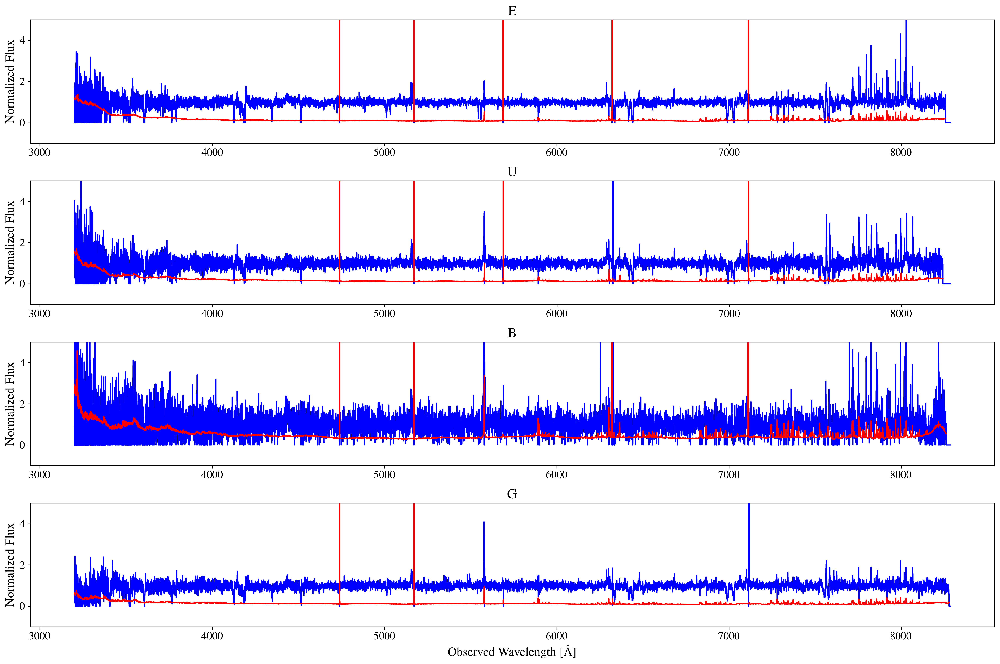

In [2]:
astro_data = '/home/ahmed/Gdrive/astro/data/'
E = ascii.read(astro_data+'rcs0327-knotE-allres-combwC1.txt')
U = ascii.read(astro_data+'rcs0327-knotU-tel-combwC1.txt')
B = ascii.read(astro_data+'rcs0327-knotB-combwC1.txt')
G = ascii.read(astro_data+'rcs0327-knotG-tel-combwC1.txt')
All = ascii.read(astro_data+'rcs0327-all-comb1.txt')

#wE = E['wave']; fE = E['fnu']; sfE = E['noise']; cE = E['cont_fnu']; cfE = E['cont_uncert']
#wU = U['wave']; fU = U['fnu']; sfU = U['noise']; cU = U['cont_fnu']; cfU = U['cont_uncert']
#wB = B['wave']; fB = B['fnu']; sfB = B['noise']; cB = B['cont_fnu']; cfB = B['cont_uncert']
#wG = G['wave']; fG = G['fnu']; sfG = G['noise']; cG = G['cont_fnu']; cfG = G['cont_uncert']

reg = [E, U, B, G]
reg_txt = ['E', 'U', 'B', 'G']

#flux_num = np.zeros(3802)
#flux_denum = np.zeros()

%matplotlib inline
plt.close()
#fig = plt.figure(1, figsize=(12,8), dpi=300)
fig, ax = plt.subplots(4,1, figsize=(18,12), constrained_layout=True, dpi=300)
#spec = gridspec.GridSpec(ncols=1, nrows=4, figure=fig)
for i in range(len(reg[:])):
    w = np.asarray(reg[i]['wave']) 
    f = np.asarray(reg[i]['fnu']) #/ np.median(np.asarray(reg[i]['fnu']) )
    sig_f = np.asarray(reg[i]['noise'])
    cont = np.asarray(reg[i]['cont_fnu'])
    c_sig = np.asarray(reg[i]['cont_uncert'])
    f_norm = f / cont
    sig_norm = sig_f/cont
    
    
    
    f_norm[f_norm < 0.0] = 0.0
    f_norm[np.isnan(f_norm)] = 0.0
    
    ax[i].step(w, f_norm, 'b-', label='flux')
    ax[i].step(w, sig_norm, 'r-', label=r'$\rm \sigma$')
    #ax[i,0].step(w, cont, 'g-', label='continuum')
    #ax[i,0].step(w, sig_f, 'r-', label=r'$\rm \sigma_{flux}$')
    #ax[i,0].step(w, c_sig, 'y-', label=r'$\rm \sigma_{continuum}$')
    ax[i].set_ylabel(r'Normalized Flux')#$\rm erg \ s^{-1} cm^{-2} Hz^{-1}$')
    ax[i].set_ylim([-1, 5])#[-0.5, 0.5])
    ax[i].set_title(reg_txt[i])
    
    
    #ax[i,1].step(w, f_norm, 'b-', label='Relative Flux')
    #ax[i,1].step(w, sig_norm, 'r-', label=r'$\rm \sigma$')
    #ax[i,1].set_ylabel('Normalized Flux')
    
ax[i].set_xlabel(r'Observed Wavelength [$\rm \AA$]')
#ax[3,1].set_xlabel(r'Observed Wavelength [$\rm \AA$]')
fig.tight_layout()
plt.show()

##  Fe II lines from MAGE for individual regions E, U, B, and G:

/home/ahmed/anaconda3/lib/python3.7/site-packages/astropy/table/column.py:1020: RuntimeWarning: invalid value encountered in less
  result = getattr(super(), op)(other)
/home/ahmed/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:28: RuntimeWarning: divide by zero encountered in true_divide
/home/ahmed/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:29: RuntimeWarning: divide by zero encountered in true_divide


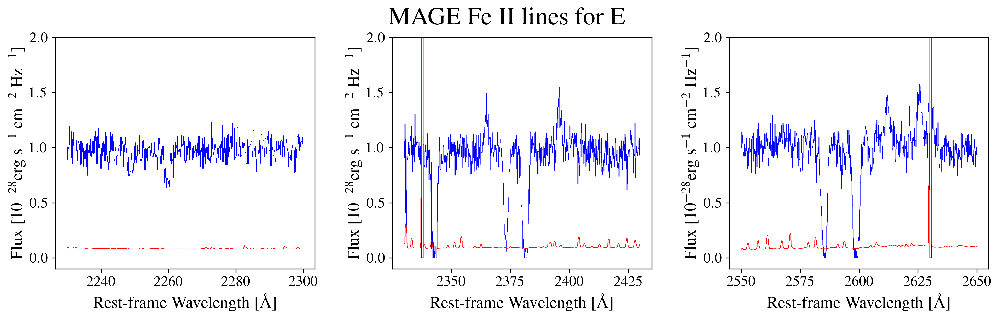

/home/ahmed/anaconda3/lib/python3.7/site-packages/astropy/table/column.py:1020: RuntimeWarning: invalid value encountered in less
  result = getattr(super(), op)(other)
/home/ahmed/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:28: RuntimeWarning: divide by zero encountered in true_divide
/home/ahmed/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:29: RuntimeWarning: divide by zero encountered in true_divide


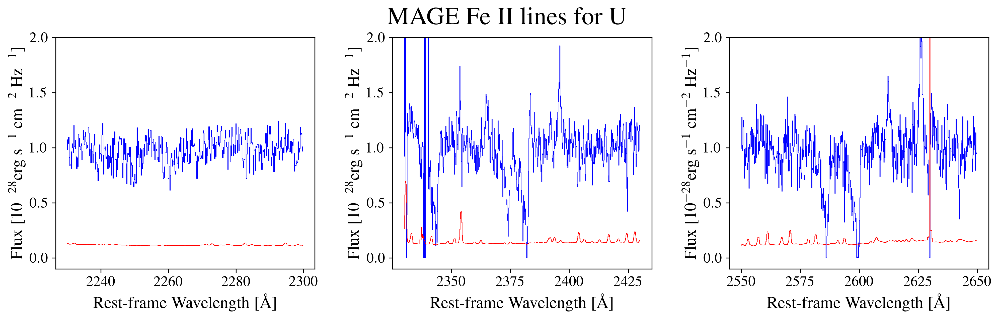

/home/ahmed/anaconda3/lib/python3.7/site-packages/astropy/table/column.py:1020: RuntimeWarning: invalid value encountered in less
  result = getattr(super(), op)(other)
/home/ahmed/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:28: RuntimeWarning: divide by zero encountered in true_divide
/home/ahmed/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:29: RuntimeWarning: divide by zero encountered in true_divide


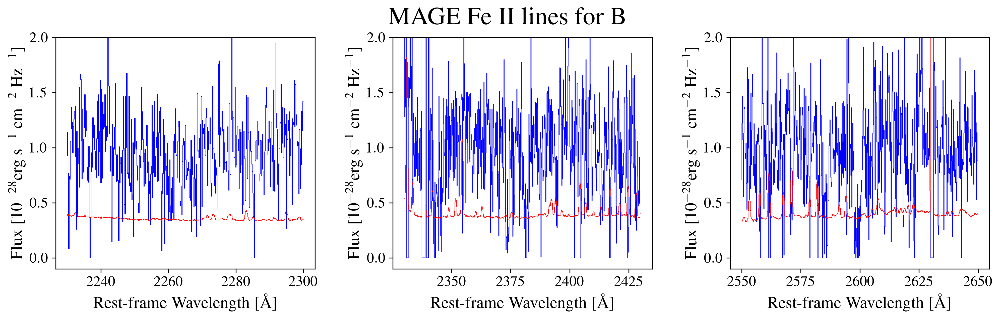

/home/ahmed/anaconda3/lib/python3.7/site-packages/astropy/table/column.py:1020: RuntimeWarning: invalid value encountered in less
  result = getattr(super(), op)(other)
/home/ahmed/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:28: RuntimeWarning: divide by zero encountered in true_divide
/home/ahmed/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:29: RuntimeWarning: divide by zero encountered in true_divide


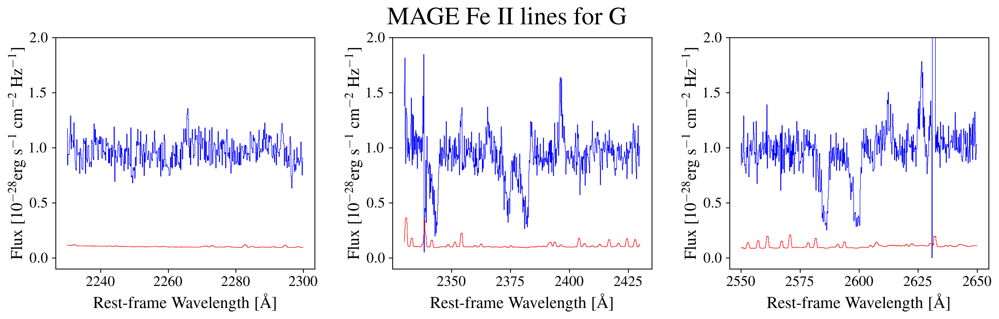

In [65]:
## The redshifts for individual regions are from Bordoloi et al. 2016:
astro_data = '/home/ahmed/Gdrive/astro/data/'
E = ascii.read(astro_data+'rcs0327-knotE-allres-combwC1.txt')
U = ascii.read(astro_data+'rcs0327-knotU-tel-combwC1.txt')
B = ascii.read(astro_data+'rcs0327-knotB-combwC1.txt')
G = ascii.read(astro_data+'rcs0327-knotG-tel-combwC1.txt')
All = ascii.read(astro_data+'rcs0327-all-comb1.txt')

#wE = E['wave']; fE = E['fnu']; sfE = E['noise']; cE = E['cont_fnu']; cfE = E['cont_uncert']
#wU = U['wave']; fU = U['fnu']; sfU = U['noise']; cU = U['cont_fnu']; cfU = U['cont_uncert']
#wB = B['wave']; fB = B['fnu']; sfB = B['noise']; cB = B['cont_fnu']; cfB = B['cont_uncert']
#wG = G['wave']; fG = G['fnu']; sfG = G['noise']; cG = G['cont_fnu']; cfG = G['cont_uncert']

reg = [E, U, B, G]
reg_txt = ['E', 'U', 'B', 'G']
fnames = ['FeII_wk', 'FeII_lw', 'FeII_hi']
z_reg = [1.7037455, 1.7038840, 1.7036000, 1.7038500]

for i in range(len(reg)):
    wave = reg[i]['wave']
    flux = reg[i]['fnu'];       
    flux_err = reg[i]['noise']; 
    cont = reg[i]['cont_fnu'];  
    arr = [flux, flux_err, cont]
    for k in range(len(arr)):
        arr[k][((arr[k] < 0.0) | np.isnan(arr[k]) )] = 0.0
    
    flux_n = flux / cont
    flux_err_n = flux_err / cont
    
    
    
    
    wrest = wave/ (1. + z_reg[i])
    
    q1 = np.where( (wrest > 2230.) & (wrest < 2300.) )
    q2 = np.where( (wrest > 2330.) & (wrest < 2430.) )
    q3 = np.where( (wrest > 2550.) & (wrest < 2650.) )

    qs = [q1, q2, q3]
    plt.close()
    fig, ax = plt.subplots(1,3, figsize=(16,4), dpi=300)
    fig.suptitle('MAGE Fe II lines for '+reg_txt[i]+'')
    for l in range(3):    
        ax[l].step(wrest[qs[l]], flux_n[qs[l]], 'b-', lw=lw)
        ax[l].step(wrest[qs[l]], flux_err_n[qs[l]], 'r-', lw=lw)
        ax[l].set_xlabel(r'Rest-frame Wavelength [$\rm \AA$]')
        ax[l].set_ylabel(r'Flux [$\rm 10^{-28} erg \ s^{-1} \ cm^{-2} \ Hz^{-1}$]')
        ax[l].set_ylim([-0.1, 2.0])
        t = Table([wave[qs[l]], flux[qs[l]], flux_err[qs[l]], cont[qs[l]], flux_n[qs[l]], flux_err_n[qs[l]]], names=['wave','flux', 'error', 'cont', 'flux_norm', 'error_norm'])
        ascii.write(t,'/home/ahmed/Gdrive/astro/analysis/spectra/spec_MAGE_'+reg_txt[i]+'_'+fnames[l]+'.dat', overwrite= True)

    fig.subplots_adjust(wspace=0.3)
    plt.show()


## MAGE Co-added Spectrum:

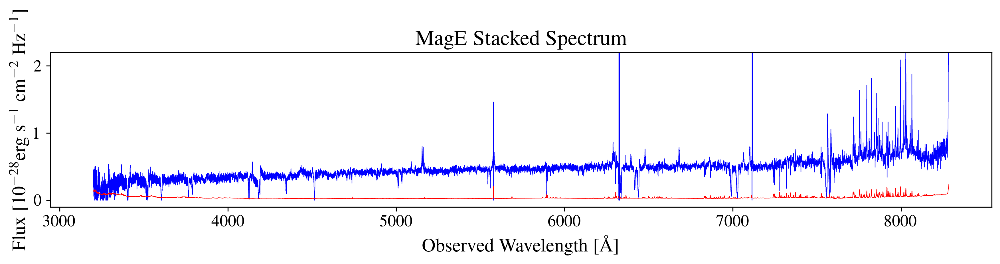

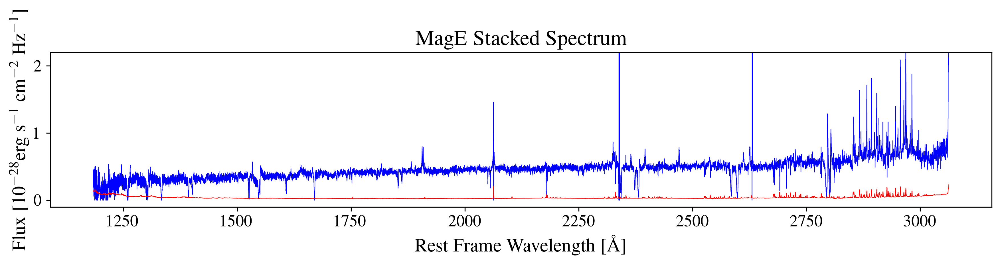

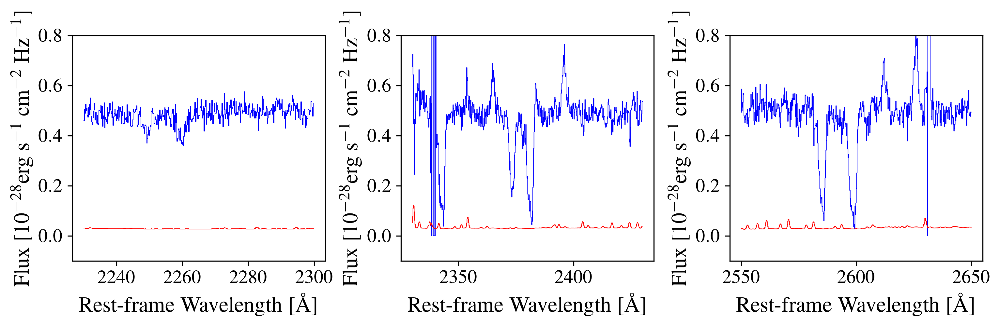

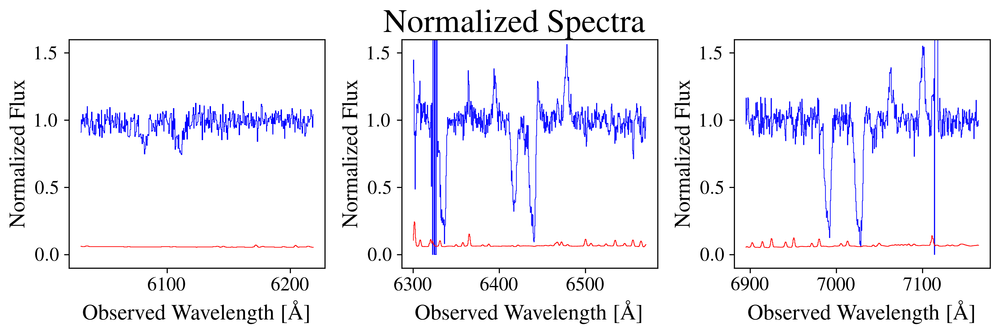

In [59]:
import pandas as pd
astro_data = '/home/ahmed/Gdrive/astro/data/'
lw = 0.5
All = ascii.read(astro_data+'rcs0327-all-comb1.txt')
wave = np.asarray(All['wave']) 
flux = np.asarray(All['fnu']) * 10**(28)
flux_err = np.asarray(All['noise']) * 10**(28)

flux[flux < 0.0] = 0.0
qnan = pd.isnull(flux)
flux[qnan] = 0.0

wrest = wave / (1. + 1.703974)

plt.close()
fig = plt.figure(1, figsize=(12,3), dpi=300)
ax = fig.add_subplot(111)
ax.step(wave, flux, 'b-', lw=lw, label='flux')
ax.step(wave, flux_err, 'r-', lw=lw, label='Error')
ax.set_xlabel(r'Observed Wavelength [$\rm \AA$]')
ax.set_ylabel(r'Flux [$\rm 10^{-28} erg \ s^{-1} \ cm^{-2} \ Hz^{-1}$]')
ax.set_title('MagE Stacked Spectrum')
ax.set_ylim(np.asarray([-0.1, 2.2]) )
fig.tight_layout()
plt.show()

plt.close()
fig = plt.figure(1, figsize=(12,3), dpi=300)
ax = fig.add_subplot(111)
ax.step(wrest, flux, 'b-', lw=lw, label='flux')
ax.step(wrest, flux_err, 'r-', lw=lw, label='Error')
ax.set_xlabel(r'Rest Frame Wavelength [$\rm \AA$]')
ax.set_ylabel(r'Flux [$\rm 10^{-28} erg \ s^{-1} \ cm^{-2} \ Hz^{-1}$]')
ax.set_title('MagE Stacked Spectrum')
ax.set_ylim(np.asarray([-0.1, 2.2]) )
fig.tight_layout()
plt.show()


q1 = np.where( (wrest > 2230.) & (wrest < 2300.) )
q2 = np.where( (wrest > 2330.) & (wrest < 2430.) )
q3 = np.where( (wrest > 2550.) & (wrest < 2650.) )

qs = [q1, q2, q3]
fnames = ['FeII_wk', 'FeII_lw', 'FeII_hi']
plt.close()
fig, ax = plt.subplots(1,3, figsize=(12,3), dpi=300)
for i in range(3):    
    ax[i].step(wrest[qs[i]], flux[qs[i]], 'b-', lw=lw)
    ax[i].step(wrest[qs[i]], flux_err[qs[i]], 'r-', lw=lw)
    ax[i].set_xlabel(r'Rest-frame Wavelength [$\rm \AA$]')
    ax[i].set_ylabel(r'Flux [$\rm 10^{-28} erg \ s^{-1} \ cm^{-2} \ Hz^{-1}$]')
    ax[i].set_ylim([-0.1, 0.8])
    t = Table([wave[qs[i]], flux[qs[i]], flux_err[qs[i]]], names=['wave','flux', 'error'])
    ascii.write(t,'/home/ahmed/Gdrive/astro/analysis/spectra/stack_magE_'+fnames[i]+'.dat')

fig.subplots_adjust(wspace=0.3)
plt.show()


s1 = ascii.read('/home/ahmed/Gdrive/astro/analysis/spectra/stack_magE_FeII_wk_norm.ascii')
s2 = ascii.read('/home/ahmed/Gdrive/astro/analysis/spectra/stack_magE_FeII_lw_norm.ascii')
s3 = ascii.read('/home/ahmed/Gdrive/astro/analysis/spectra/stack_magE_FeII_hi_norm.ascii')

lw = 0.5
ss = [s1, s2, s3]
plt.close()
fig, ax = plt.subplots(1,3, figsize=(12,3), dpi=300)
fig.suptitle('Normalized Spectra')
for i in range(3):
    wl = np.asarray(ss[i]['wave'])#/1.703974047833502
    f_n = np.asarray(ss[i]['flux'])/np.asarray(ss[i]['cont'])
    fr_n = np.asarray(ss[i]['error'])/np.asarray(ss[i]['cont'])
    ax[i].step(wl, f_n, 'b-', lw=lw)
    ax[i].step(wl, fr_n, 'r-', lw=lw)
    ax[i].set_xlabel(r'Observed Wavelength [$\rm \AA$]')
    ax[i].set_ylabel(r'Normalized Flux')
    ax[i].set_ylim([-0.1, 1.6])


fig.subplots_adjust(wspace=0.3)
plt.show()


In [60]:
for i in range(4):
    w = np.asarray(reg[i]['wave'])
    print(len(w))
    print(w[0], w[-1])
    print(' - - - - - - - - ')
    wo = w[np.where( (w >=  3200.1722) & (w <= 8283.5368) )]
    print(len(wo))
    print(wo[0], wo[-1])
    #print(reg[i]['wave'][0], reg[i]['wave'][-1])
    print(' = = = = = = = = =')

13138
3200.2173 8285.0407
 - - - - - - - - 
13135
3200.2173 8283.3177
 = = = = = = = = =
13141
3200.1722 8283.5368
 - - - - - - - - 
13141
3200.1722 8283.5368
 = = = = = = = = =
13147
3200.0708 8286.1638
 - - - - - - - - 
13141
3200.3127 8283.2918
 = = = = = = = = =
13144
3200.0813 8285.9058
 - - - - - - - - 
13138
3200.3233 8283.034
 = = = = = = = = =


## Fitting the Fe II lines from MUSE data:

  0%|          | 0/1500 [00:00<?, ?it/s]/home/ahmed/anaconda3/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|██████████| 1500/1500 [01:59<00:00, 12.60it/s]


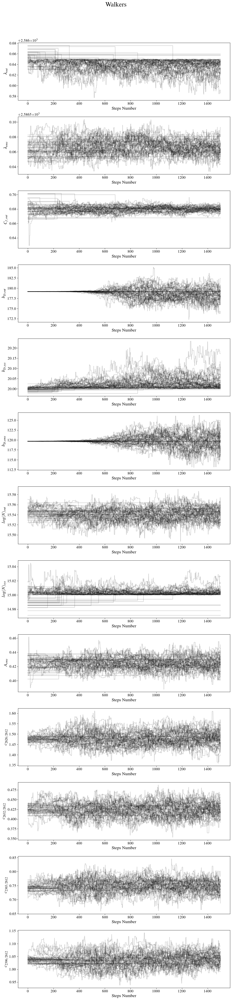

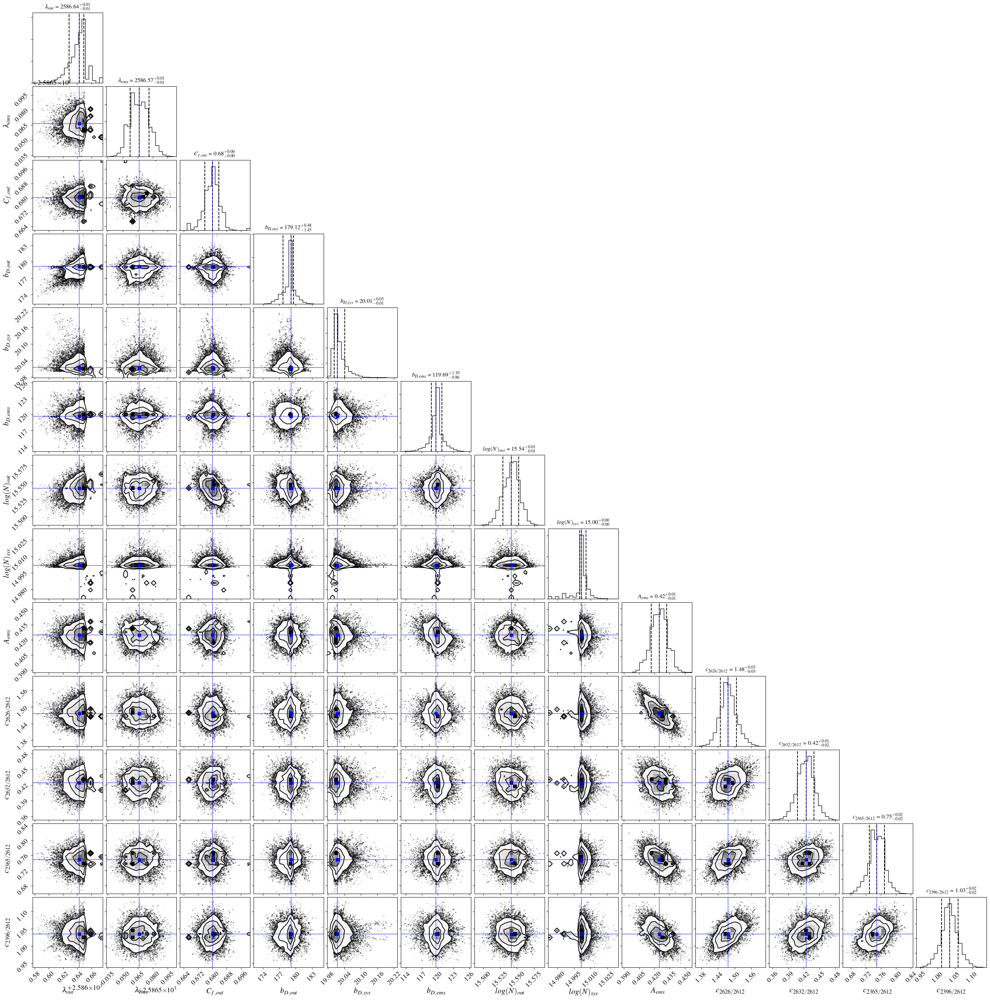

[2586.6426638131693, 2586.5664026952677, 0.6801069591314015, 179.1241716055155, 20.013959531167707, 119.69141975945777, 15.541682013339386, 15.001788505407653, 0.4247059257857705, 1.476163842165741, 0.4243148303112861, 0.7491249612371726, 1.0347392314370105]


In [42]:
fe1 = ascii.read('/home/ahmed/Gdrive/astro/analysis/spectra/spectrum_FeII_wk_stack_wl_norm.ascii')
fe2 = ascii.read('/home/ahmed/Gdrive/astro/analysis/spectra/stacked_spectrum_FeII_low_wl_norm.ascii')
fe3 = ascii.read('/home/ahmed/Gdrive/astro/analysis/spectra/spectrum_FeII_hi_stack_wl.dat')
w1 = np.asarray(fe1['wave']); f1 = np.asarray(fe1['flux']); fer1 = np.asarray(fe1['error']); cnt1 = np.asarray(fe1['cont'])
w2 = np.asarray(fe2['wave']); f2 = np.asarray(fe2['flux']); fer2 = np.asarray(fe2['error']); cnt2 = np.asarray(fe2['cont'])
f1_n = f1 / cnt1; fer1_n = fer1 / cnt1
f2_n = f2 / cnt2; fer2_n = fer2 / cnt2 
w3 = np.asarray(fe3['wave']); f3_n = np.asarray(fe3['flux_norm']); fer3_n = np.asarray(fe3['flux_err_norm'])

wave = np.asarray([*w1, *w2, *w3])
wave = u.airtovac(wave)
flux_norm = np.asarray([*f1_n, *f2_n, *f3_n])
flux_err_norm = np.asarray([*fer1_n, *fer2_n, *fer3_n])

z = 1.703974047833502
wrest = wave / (1. + z)
vel = u.veldiff(wrest, 2586.650)

q_lim_abs = np.where( (vel > -500.) & (vel < 0.0))
q_lim_ems = np.where( (vel > -200.) & ( vel < 200.))

wlim_abs = wrest[q_lim_abs]
wlim_ems = wrest[q_lim_ems]

#vel 
p_names = [r'$\lambda_{out}$', r'$\lambda_{ems}$', r'$C_{f,out}$', r'$b_{D, out}$', '$b_{D, sys}$', r'$b_{D, ems}$', r'$log(N)_{out}$', r'$log(N)_{sys}$',
          r'$A_{ems}$', r'$c_{2626/2612}$', r'$c_{2632/2612}$', r'$c_{2365/2612}$', r'$c_{2396/2612}$'] #, r'$C_{f,sys}$'

#       l_out,             l_ems,Cf_out, b_Do, b_Ds, b_De, logN, logNs,   A, ce1, ce2, ce3, ce4)
p0   = [     2586.0,      2586.9,   0.8, 200., 100., 150., 14.0,  15.5, 1.0, 1.2, 0.5, 1.0, 1.0]
p_lw = [wlim_abs[0], wlim_ems[0],   0.1, 100., 20.0, 100., 13.0,   15., 0.0, 1.0, 0.0, 0.0, 0.0]
p_up = [   2586.650, wlim_ems[-1],  1.0, 600., 300., 600., 16.0,   17., 5.0, 4.0, 2.0, 4.0, 4.0]


names = ["FeII2586","stack_wl_Cfvary"]

samples_dir = '/home/ahmed/Gdrive/astro/analysis/emcee/FeII/samples/'
corner_dir = '/home/ahmed/Gdrive/astro/analysis/emcee/FeII/corner/'
walkers_dir = '/home/ahmed/Gdrive/astro/analysis/emcee/FeII/walkers/'


p_opt, up_sig, lw_sig = u.emcee_fit(model_FeII_wave_full, wrest, flux_norm, flux_err_norm, p0, p_lw, p_up, p_names, names, samples_dir, walkers_dir, corner_dir, plot=True, write= False)
print(p_opt)
output = model_FeII_wave_full_comps(wrest, *p_opt) 


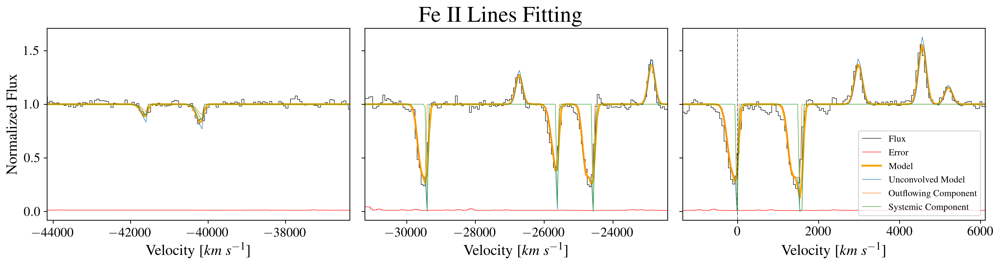

In [46]:
fe1 = ascii.read('/home/ahmed/Gdrive/astro/analysis/spectra/spectrum_FeII_wk_stack_wl_norm.ascii')
fe2 = ascii.read('/home/ahmed/Gdrive/astro/analysis/spectra/stacked_spectrum_FeII_low_wl_norm.ascii')
fe3 = ascii.read('/home/ahmed/Gdrive/astro/analysis/spectra/spectrum_FeII_hi_stack_wl.dat')
w1 = np.asarray(fe1['wave']); f1 = np.asarray(fe1['flux']); fer1 = np.asarray(fe1['error']); cnt1 = np.asarray(fe1['cont'])
w2 = np.asarray(fe2['wave']); f2 = np.asarray(fe2['flux']); fer2 = np.asarray(fe2['error']); cnt2 = np.asarray(fe2['cont'])
f1_n = f1 / cnt1; fer1_n = fer1 / cnt1
f2_n = f2 / cnt2; fer2_n = fer2 / cnt2 
w3 = np.asarray(fe3['wave']); f3_n = np.asarray(fe3['flux_norm']); fer3_n = np.asarray(fe3['flux_err_norm'])

wave = np.asarray([*w1, *w2, *w3])
wave = u.airtovac(wave)
flux_norm = np.asarray([*f1_n, *f2_n, *f3_n])
flux_err_norm = np.asarray([*fer1_n, *fer2_n, *fer3_n])

#model_FeII_wave_full(wrest, lam_out, lam_ems, Cf_out, Cf_sys, b_D_out, b_D_sys, b_D_ems, logN_out, logN_sys, A, c_ems1, c_ems2, c_ems3, c_ems4):
z = 1.703974047833502
wrest = wave / (1. + z)

vel = u.veldiff(wrest, 2586.650)
#p = np.load('/home/ahmed/Gdrive/astro/analysis/emcee/FeII/samples/samplesFeII2586_stack_wl_Cfvary.npy')
#p_opt = np.median(p, axis=0)
#output = model_FeII_wave_full_comps(wrest, *p_opt)
#F_conv, F, F_out, F_sys, F_ems, F_out0, F_out1, F_out2, F_out3, F_out4, F_out5, F_out6, F_ems0, F_ems1, F_ems2, F_ems3, F_ems4

F_conv = output['F_conv']
F = output['F_unconv']
F_ems = output['F_ems']
F_sys = output['Systemic']
F_out = output['F_out']

vlim_1 = u.veldiff(np.array([2230., 2290.]), 2586.650)#[vel[0], -22000.0]
vlim_2 = u.veldiff(np.array([2330., 2400.]), 2586.650)
vlim_3 = u.veldiff(np.array([2575., 2640.]), 2586.650)#[-1900.0, 7000.0]
lw = 0.5

plt.close()
fig, ax = plt.subplots(1, 3, figsize=(15,4), sharey = True, dpi=300)
fig.suptitle('Fe II Lines Fitting')

ax[0].step(vel, flux_norm, 'k-', lw=lw, label='Flux')
ax[0].step(vel, flux_err_norm, 'r-', lw=lw, label='Error')
ax[0].plot(vel, F_conv, c='orange', lw=2.0, label='Model')
ax[0].plot(vel, F, lw = lw, label='Unconvolved Model')
ax[0].plot(vel, F_out, lw=lw, label='Outflowing Component')
ax[0].plot(vel, F_sys, lw=lw, label='Systemic Component')
ax[0].set_xlabel(r'Velocity [$km \ s^{-1}$]')
ax[0].set_ylabel('Normalized Flux')
ax[0].set_xlim(vlim_1)
#ax0.legend(loc=0)
ax[0].axvline(x=0.0, c='k', lw=lw, ls='-.')
#ax[0].axhline(y=1.0, c='k', lw=lw, ls='--')

ax[1].step(vel, flux_norm, 'k-', lw=lw, label='Flux')
ax[1].step(vel, flux_err_norm, 'r-', lw=lw, label='Error')
ax[1].plot(vel, F_conv, c='orange', lw=2.0, label='Model')
ax[1].plot(vel, F, lw = lw, label='Unconvolved Model')
ax[1].plot(vel, F_out, lw=lw, label='Outflowing Component')
ax[1].plot(vel, F_sys, lw=lw, label='Systemic Component')
ax[1].set_xlabel(r'Velocity [$km \ s^{-1}$]')
#ax[1].set_ylabel('Normalized Flux')
ax[1].set_xlim(vlim_2)
#ax1.legend(loc=0)
ax[1].axvline(x=0.0, c='k', lw=lw, ls='-.')
#ax[1].axhline(y=1.0, c='k', lw=lw, ls='--')

#ax2 = fig.add_subplot(122)
ax[2].step(vel, flux_norm, 'k-', lw=lw, label='Flux')
ax[2].step(vel, flux_err_norm, 'r-', lw=lw, label='Error')
ax[2].plot(vel, F_conv, c='orange', lw=2.0, label='Model')
ax[2].plot(vel, F, lw = lw, label='Unconvolved Model')
ax[2].plot(vel, F_out, lw=lw, label='Outflowing Component')
ax[2].plot(vel, F_sys, lw=lw, label='Systemic Component')

ax[2].set_xlabel(r'Velocity [$km \ s^{-1}$]')
#ax[2].set_ylabel('Normalized Flux')
ax[2].set_xlim(vlim_3)
ax[2].legend(loc=4, fontsize='small')
ax[2].axvline(x=0.0, c='k', lw=lw, ls='-.')
#ax[2].axhline(y=1.0, c='k', lw=lw, ls='--')
fig.tight_layout()
fig.subplots_adjust(wspace=0.05, top=0.9)
plt.show()

In [47]:
pi = np.load('/home/ahmed/Gdrive/astro/analysis/emcee/FeII/samples/samplesFeII2586_stack_wl_Cfvary.npy')
p_ii = np.median(pi, axis=0)
p_ii

array([2.58664241e+03, 2.58656693e+03, 6.54728828e-01, 5.00926507e-01,
       1.75038948e+02, 5.00326435e+01, 1.19703549e+02, 1.56280145e+01,
       1.49671377e+01, 4.24014034e-01, 1.47654161e+00, 4.24273346e-01,
       7.44608824e-01, 1.03555643e+00])

## Fitting Fe II from MAGE Stacked Spectrum:

  0%|          | 0/1500 [00:00<?, ?it/s]/home/ahmed/anaconda3/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|██████████| 1500/1500 [01:30<00:00, 16.66it/s]


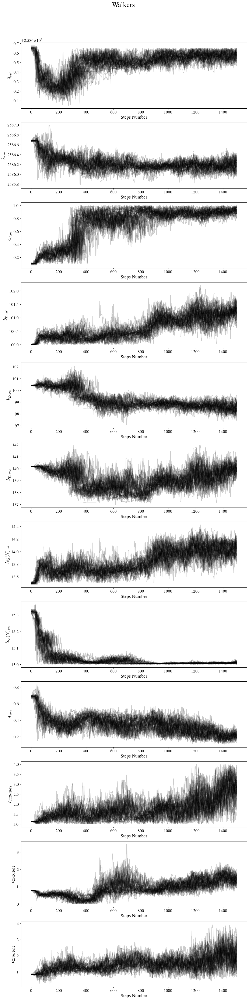

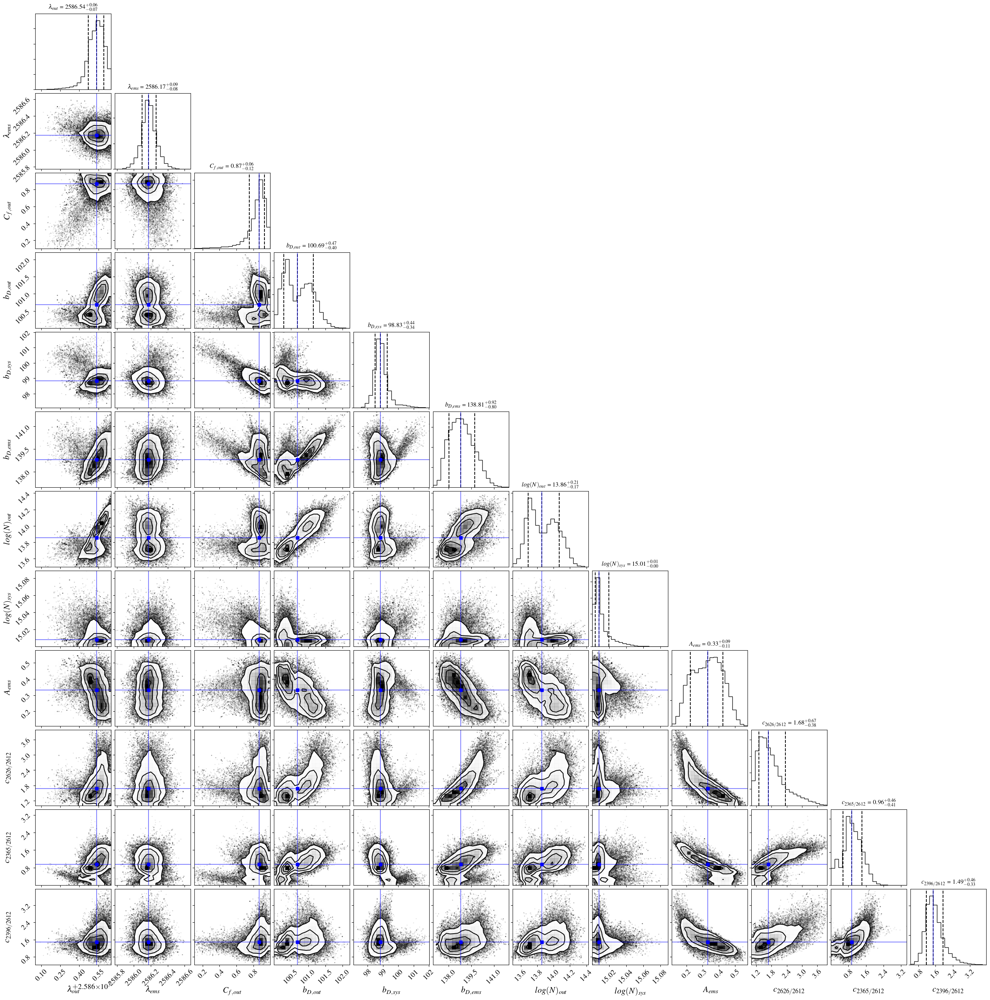

[2586.5367258893293, 2586.1746225285624, 0.8679604462275569, 100.6856965421602, 98.82678515532076, 138.8104208792821, 13.857120538331387, 15.007835090266067, 0.332152643207745, 1.6773853223491884, 0.9570642016626612, 1.4857716093394202]


In [54]:
s1 = ascii.read('/home/ahmed/Gdrive/astro/analysis/spectra/stack_magE_FeII_wk_norm.ascii')
s2 = ascii.read('/home/ahmed/Gdrive/astro/analysis/spectra/stack_magE_FeII_lw_norm.ascii')
s3 = ascii.read('/home/ahmed/Gdrive/astro/analysis/spectra/stack_magE_FeII_hi_norm.ascii')

w1 = s1['wave']; f1_n = np.asarray(s1['flux'])/np.asarray(s1['cont']); fer1_n = np.asarray(s1['error'])/np.asarray(s1['cont'])
w2 = s2['wave']; f2_n = np.asarray(s2['flux'])/np.asarray(s2['cont']); fer2_n = np.asarray(s2['error'])/np.asarray(s2['cont'])
w3 = s3['wave']; f3_n = np.asarray(s3['flux'])/np.asarray(s3['cont']); fer3_n = np.asarray(s3['error'])/np.asarray(s3['cont'])

wave = np.asarray([*w1, *w2, *w3])
flux_norm = np.asarray([*f1_n, *f2_n, *f3_n])
flux_err_norm = np.asarray([*fer1_n, *fer2_n, *fer3_n])

z = 1.703974047833502
wrest = wave / (1. + z)
vel = u.veldiff(wrest, 2586.650)
qq = np.where(wrest > 2630.)
flux_norm[qq] = 1.

q_lim_abs = np.where( (vel > -500.) & (vel < 0.0))
q_lim_ems = np.where( (vel > -200.) & ( vel < 200.))

wlim_abs = wrest[q_lim_abs]
wlim_ems = wrest[q_lim_ems]

#vel 
p_names = [r'$\lambda_{out}$', r'$\lambda_{ems}$', r'$C_{f,out}$', r'$b_{D, out}$', '$b_{D, sys}$', r'$b_{D, ems}$', r'$log(N)_{out}$', r'$log(N)_{sys}$',
          r'$A_{ems}$', r'$c_{2626/2612}$', r'$c_{2365/2612}$', r'$c_{2396/2612}$'] # , r'$C_{f,sys}$' , r'$c_{2632/2612}$'


#       l_out,             l_ems, Cf_out,b_Do, b_Ds, b_De, logN, logNs,   A, ce1, ce3, ce4)
p0   = [     2586.0,      2586.9,   0.8, 200., 100., 150., 14.0,  15.5, 1.0, 1.2, 1.0, 1.0]
p_lw = [wlim_abs[0], wlim_ems[0],   0.1, 100., 20.0, 100., 13.5,  15.0, 0.0, 1.0, 0.0, 0.0]
p_up = [   2586.650, wlim_ems[-1],  1.0, 600., 300., 600., 16.0,  17.0, 5.0, 4.0, 4.0, 4.0]

names = ["FeII2586","stack_mage_Cfvary"]

samples_dir = '/home/ahmed/Gdrive/astro/analysis/emcee/FeII/samples/'
corner_dir = '/home/ahmed/Gdrive/astro/analysis/emcee/FeII/corner/'
walkers_dir = '/home/ahmed/Gdrive/astro/analysis/emcee/FeII/walkers/'


p_opt, up_sig, lw_sig = u.emcee_fit(model_FeII_wave_MagE, wrest, flux_norm, flux_err_norm, p0, p_lw, p_up, p_names, names, samples_dir, walkers_dir, corner_dir, plot=True, write=True)
print(p_opt)
output = model_FeII_wave_MagE_comps(wrest, *p_opt) 


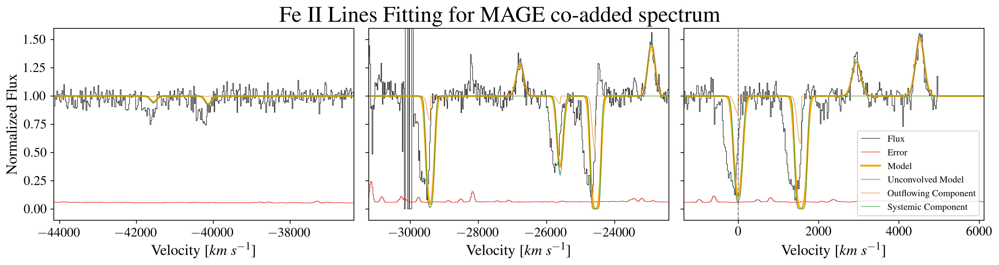

In [57]:
s1 = ascii.read('/home/ahmed/Gdrive/astro/analysis/spectra/stack_magE_FeII_wk_norm.ascii')
s2 = ascii.read('/home/ahmed/Gdrive/astro/analysis/spectra/stack_magE_FeII_lw_norm.ascii')
s3 = ascii.read('/home/ahmed/Gdrive/astro/analysis/spectra/stack_magE_FeII_hi_norm.ascii')

w1 = s1['wave']; f1_n = np.asarray(s1['flux'])/np.asarray(s1['cont']); fer1_n = np.asarray(s1['error'])/np.asarray(s1['cont'])
w2 = s2['wave']; f2_n = np.asarray(s2['flux'])/np.asarray(s2['cont']); fer2_n = np.asarray(s2['error'])/np.asarray(s2['cont'])
w3 = s3['wave']; f3_n = np.asarray(s3['flux'])/np.asarray(s3['cont']); fer3_n = np.asarray(s3['error'])/np.asarray(s3['cont'])

wave = np.asarray([*w1, *w2, *w3])
flux_norm = np.asarray([*f1_n, *f2_n, *f3_n])
flux_err_norm = np.asarray([*fer1_n, *fer2_n, *fer3_n])



#model_FeII_wave_full(wrest, lam_out, lam_ems, Cf_out, Cf_sys, b_D_out, b_D_sys, b_D_ems, logN_out, logN_sys, A, c_ems1, c_ems2, c_ems3, c_ems4):
z = 1.703974047833502
wrest = wave / (1. + z)
qq = np.where(wrest > 2630.)
flux_norm[qq] = 1.

vel = u.veldiff(wrest, 2586.650)
#p = np.load('/home/ahmed/Gdrive/astro/analysis/emcee/FeII/samples/samplesFeII2586_stack_mage_Cfvary.npy')
#p_opt = np.median(p, axis=0)
output = model_FeII_wave_MagE_comps(wrest, *p_opt)
F_conv = output['F_conv']
F = output['F_unconv']
F_out = output['F_out']
F_sys = output['F_sys']




vlim_1 = u.veldiff(np.array([2230., 2290.]), 2586.650)#[vel[0], -22000.0]
vlim_2 = u.veldiff(np.array([2330., 2400.]), 2586.650)
vlim_3 = u.veldiff(np.array([2575., 2640.]), 2586.650)#[-1900.0, 7000.0]
lw = 0.5

ylm = [-0.1, 1.6]
plt.close()
fig, ax = plt.subplots(1, 3, figsize=(15,4), sharey = True, dpi=300)
fig.suptitle('Fe II Lines Fitting for MAGE co-added spectrum')

ax[0].step(vel, flux_norm, 'k-', lw=lw, label='Flux')
ax[0].step(vel, flux_err_norm, 'r-', lw=lw, label='Error')
ax[0].plot(vel, F_conv, c='orange', lw=2.0, label='Model')
ax[0].plot(vel, F, lw = lw, label='Unconvolved Model')
ax[0].plot(vel, F_out, lw=lw, label='Outflowing Component')
ax[0].plot(vel, F_sys, lw=lw, label='Systemic Component')
ax[0].set_xlabel(r'Velocity [$km \ s^{-1}$]')
ax[0].set_ylabel('Normalized Flux')
ax[0].set_xlim(vlim_1)
ax[0].set_ylim(ylm)
#ax0.legend(loc=0)
ax[0].axvline(x=0.0, c='k', lw=lw, ls='-.')
#ax[0].axhline(y=1.0, c='k', lw=lw, ls='--')

ax[1].step(vel, flux_norm, 'k-', lw=lw, label='Flux')
ax[1].step(vel, flux_err_norm, 'r-', lw=lw, label='Error')
ax[1].plot(vel, F_conv, c='orange', lw=2.0, label='Model')
ax[1].plot(vel, F, lw = lw, label='Unconvolved Model')
ax[1].plot(vel, F_out, lw=lw, label='Outflowing Component')
ax[1].plot(vel, F_sys, lw=lw, label='Systemic Component')
ax[1].set_xlabel(r'Velocity [$km \ s^{-1}$]')
#ax[1].set_ylabel('Normalized Flux')
ax[1].set_xlim(vlim_2)
ax[1].set_ylim(ylm)
#ax1.legend(loc=0)
ax[1].axvline(x=0.0, c='k', lw=lw, ls='-.')
#ax[1].axhline(y=1.0, c='k', lw=lw, ls='--')

#ax2 = fig.add_subplot(122)
ax[2].step(vel, flux_norm, 'k-', lw=lw, label='Flux')
ax[2].step(vel, flux_err_norm, 'r-', lw=lw, label='Error')
ax[2].plot(vel, F_conv, c='orange', lw=2.0, label='Model')
ax[2].plot(vel, F, lw = lw, label='Unconvolved Model')
ax[2].plot(vel, F_out, lw=lw, label='Outflowing Component')
ax[2].plot(vel, F_sys, lw=lw, label='Systemic Component')

ax[2].set_xlabel(r'Velocity [$km \ s^{-1}$]')
#ax[2].set_ylabel('Normalized Flux')
ax[2].set_xlim(vlim_3)
ax[2].set_ylim(ylm)
ax[2].legend(loc=4, fontsize='small')
ax[2].axvline(x=0.0, c='k', lw=lw, ls='-.')
#ax[2].axhline(y=1.0, c='k', lw=lw, ls='--')
fig.tight_layout()
fig.subplots_adjust(wspace=0.05, top=0.9)
plt.show()



## Fitting Fe II lines for regions E and G from MAGE data: (U, and B have very noisy spectra)

  0%|          | 0/1500 [00:00<?, ?it/s]/home/ahmed/anaconda3/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|██████████| 1500/1500 [01:14<00:00, 20.12it/s]


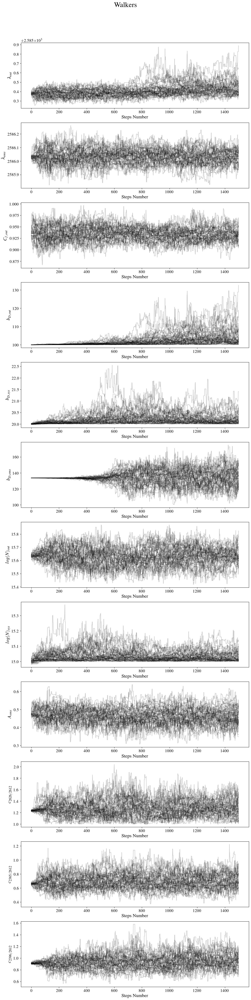

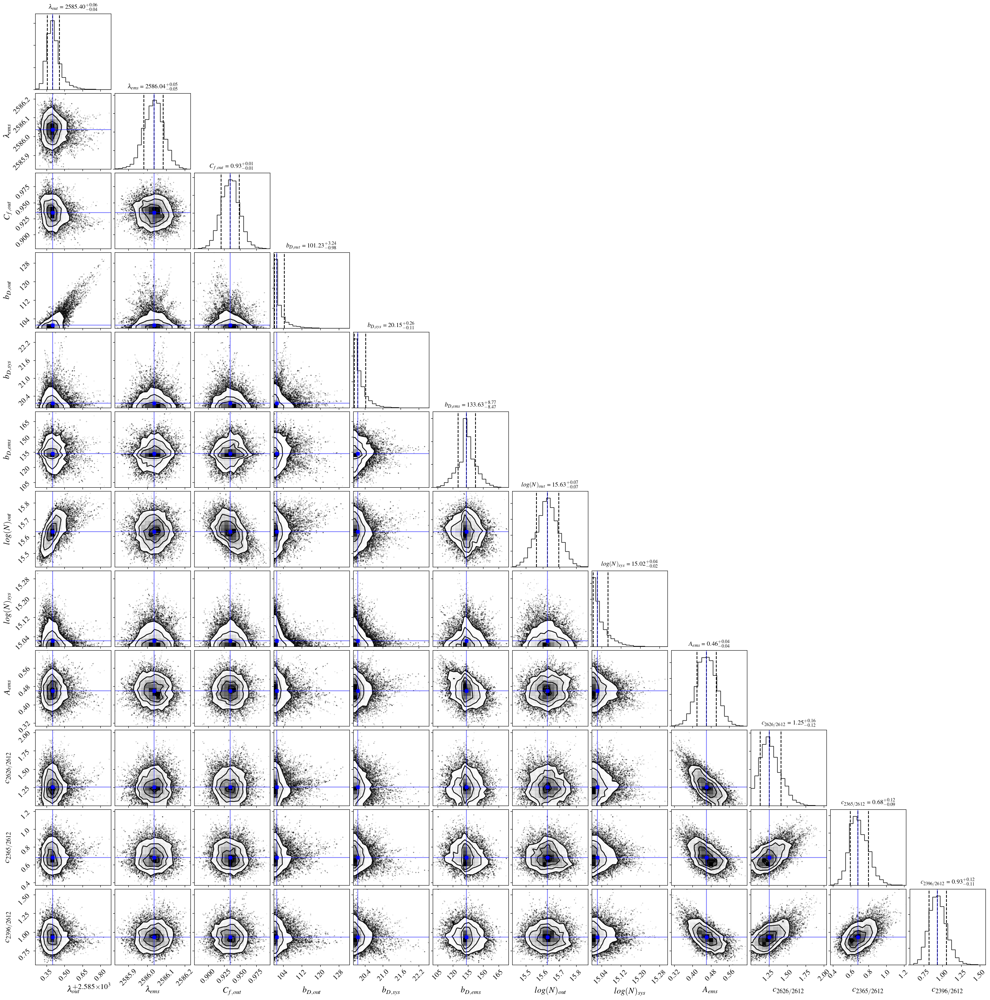

[2585.3987933726935, 2586.035572838225, 0.934684933026054, 101.22820320043014, 20.15041346022618, 133.62982631264993, 15.628210724271472, 15.023658745369495, 0.4603360473942401, 1.2543402006944977, 0.6842664485494678, 0.9325573953815418]


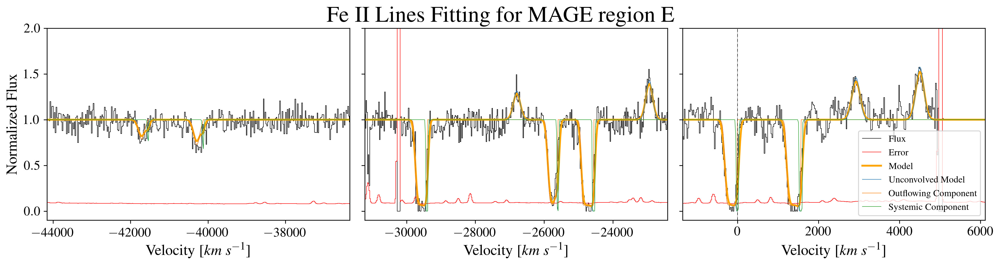

  0%|          | 0/1500 [00:00<?, ?it/s]/home/ahmed/anaconda3/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|██████████| 1500/1500 [01:08<00:00, 21.92it/s]


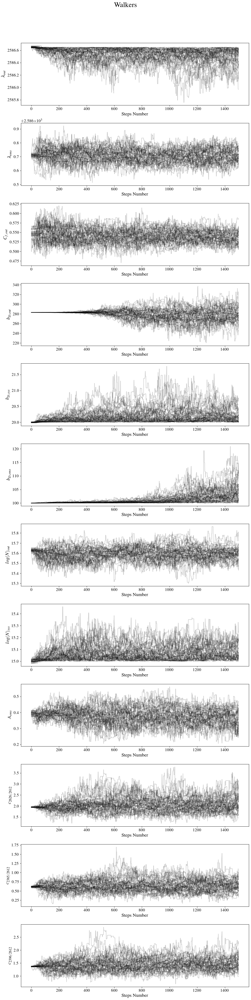

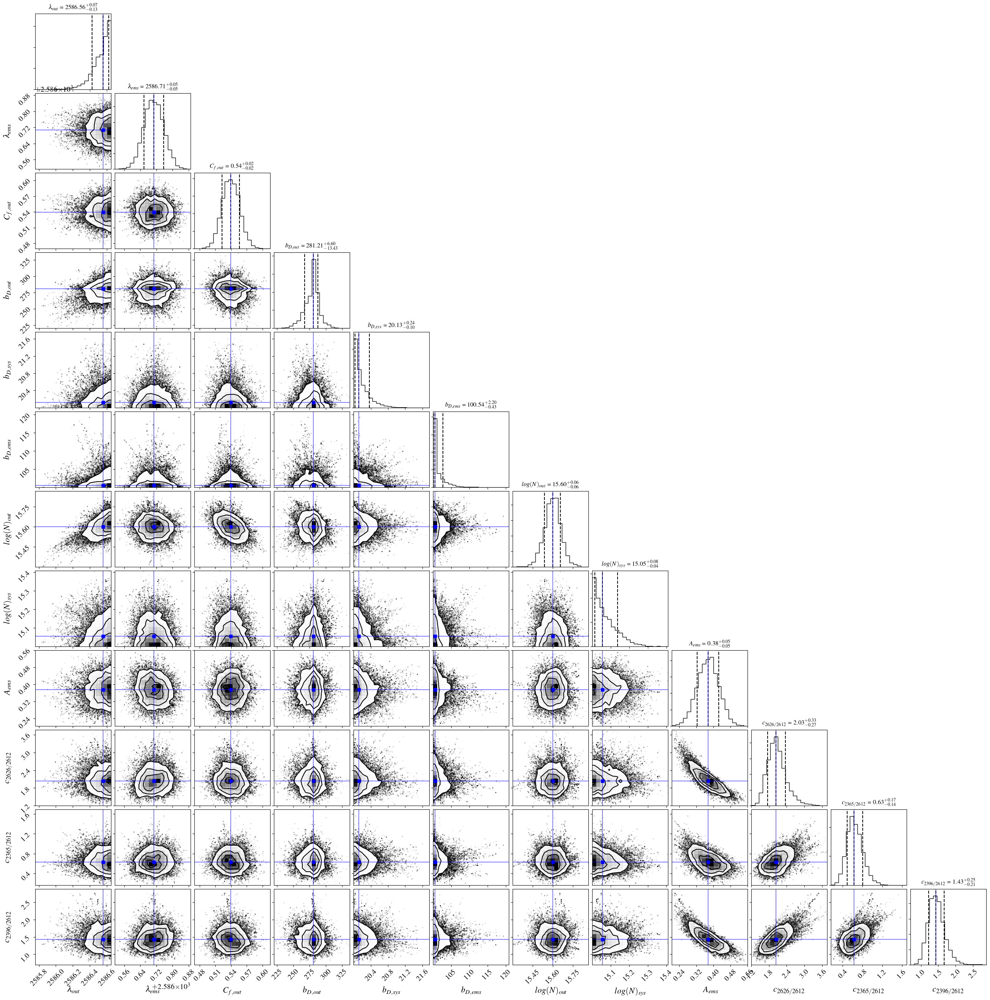

[2586.5555966842653, 2586.7064118536655, 0.5394527107602668, 281.2074558354331, 20.126559592559396, 100.54490491162257, 15.599050114463939, 15.054800311573228, 0.37565795799633706, 2.0291242856066622, 0.6300762323647008, 1.4268266269509189]


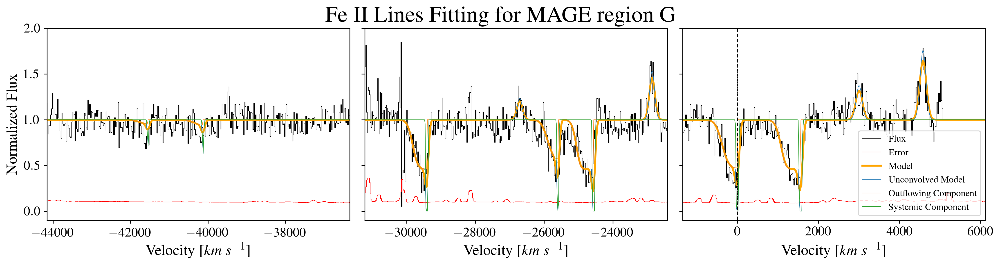

In [71]:
fnames = ['FeII_wk', 'FeII_lw', 'FeII_hi']
reg_names = ['E', 'G']
z_rg = [1.7037455, 1.70385]
for i in range(len(reg_names)):
    s1 =  ascii.read('/home/ahmed/Gdrive/astro/analysis/spectra/spec_MAGE_'+reg_names[i]+'_'+fnames[0]+'.dat')
    s2 =  ascii.read('/home/ahmed/Gdrive/astro/analysis/spectra/spec_MAGE_'+reg_names[i]+'_'+fnames[1]+'.dat')
    s3 =  ascii.read('/home/ahmed/Gdrive/astro/analysis/spectra/spec_MAGE_'+reg_names[i]+'_'+fnames[2]+'.dat')
    
    w1 = s1['wave']; f1_n = np.asarray(s1['flux'])/np.asarray(s1['cont']); fer1_n = np.asarray(s1['error'])/np.asarray(s1['cont'])
    w2 = s2['wave']; f2_n = np.asarray(s2['flux'])/np.asarray(s2['cont']); fer2_n = np.asarray(s2['error'])/np.asarray(s2['cont'])
    w3 = s3['wave']; f3_n = np.asarray(s3['flux'])/np.asarray(s3['cont']); fer3_n = np.asarray(s3['error'])/np.asarray(s3['cont'])

    wave = np.asarray([*w1, *w2, *w3])
    flux_norm = np.asarray([*f1_n, *f2_n, *f3_n])
    flux_err_norm = np.asarray([*fer1_n, *fer2_n, *fer3_n])
    
    wrest = wave / (1. + z_rg[i])
    vel = u.veldiff(wrest, 2586.650)
    qq = np.where(wrest > 2631.)
    flux_norm[qq] = 1.
    
    wlim_abs = wrest[q_lim_abs]
    wlim_ems = wrest[q_lim_ems]

    #vel 
    p_names = [r'$\lambda_{out}$', r'$\lambda_{ems}$', r'$C_{f,out}$', r'$b_{D, out}$', '$b_{D, sys}$', r'$b_{D, ems}$', r'$log(N)_{out}$', r'$log(N)_{sys}$',
              r'$A_{ems}$', r'$c_{2626/2612}$', r'$c_{2365/2612}$', r'$c_{2396/2612}$'] # , r'$C_{f,sys}$' , r'$c_{2632/2612}$'


    #       l_out,             l_ems, Cf_out,b_Do, b_Ds, b_De, logN, logNs,   A, ce1, ce3, ce4)
    p0   = [     2586.0,      2586.9,   0.8, 200., 100., 150., 14.0,  15.5, 1.0, 1.2, 1.0, 1.0]
    p_lw = [wlim_abs[0], wlim_ems[0],   0.1, 100., 20.0, 100., 13.5,  15.0, 0.0, 1.0, 0.0, 0.0]
    p_up = [   2586.650, wlim_ems[-1],  1.0, 600., 300., 600., 16.0,  17.0, 5.0, 4.0, 4.0, 4.0]

    names = ["FeII2586","mage_"+reg_names[i]+"_Cfvary"]

    samples_dir = '/home/ahmed/Gdrive/astro/analysis/emcee/FeII/samples/'
    corner_dir = '/home/ahmed/Gdrive/astro/analysis/emcee/FeII/corner/'
    walkers_dir = '/home/ahmed/Gdrive/astro/analysis/emcee/FeII/walkers/'


    p_opt, up_sig, lw_sig = u.emcee_fit(model_FeII_wave_MagE, wrest, flux_norm, flux_err_norm, p0, p_lw, p_up, p_names, names, samples_dir, walkers_dir, corner_dir, plot=True, write=True)
    print(p_opt)
    output = model_FeII_wave_MagE_comps(wrest, *p_opt) 
    
    F_conv = output['F_conv']
    F = output['F_unconv']
    F_out = output['F_out']
    F_sys = output['F_sys']




    vlim_1 = u.veldiff(np.array([2230., 2290.]), 2586.650)#[vel[0], -22000.0]
    vlim_2 = u.veldiff(np.array([2330., 2400.]), 2586.650)
    vlim_3 = u.veldiff(np.array([2575., 2640.]), 2586.650)#[-1900.0, 7000.0]
    lw = 0.5

    ylm = [-0.1, 2.0]
    plt.close()
    fig, ax = plt.subplots(1, 3, figsize=(15,4), sharey = True, dpi=300)
    fig.suptitle('Fe II Lines Fitting for MAGE region '+reg_names[i]+' ')

    ax[0].step(vel, flux_norm, 'k-', lw=lw, label='Flux')
    ax[0].step(vel, flux_err_norm, 'r-', lw=lw, label='Error')
    ax[0].plot(vel, F_conv, c='orange', lw=2.0, label='Model')
    ax[0].plot(vel, F, lw = lw, label='Unconvolved Model')
    ax[0].plot(vel, F_out, lw=lw, label='Outflowing Component')
    ax[0].plot(vel, F_sys, lw=lw, label='Systemic Component')
    ax[0].set_xlabel(r'Velocity [$km \ s^{-1}$]')
    ax[0].set_ylabel('Normalized Flux')
    ax[0].set_xlim(vlim_1)
    ax[0].set_ylim(ylm)
    #ax0.legend(loc=0)
    ax[0].axvline(x=0.0, c='k', lw=lw, ls='-.')
    #ax[0].axhline(y=1.0, c='k', lw=lw, ls='--')

    ax[1].step(vel, flux_norm, 'k-', lw=lw, label='Flux')
    ax[1].step(vel, flux_err_norm, 'r-', lw=lw, label='Error')
    ax[1].plot(vel, F_conv, c='orange', lw=2.0, label='Model')
    ax[1].plot(vel, F, lw = lw, label='Unconvolved Model')
    ax[1].plot(vel, F_out, lw=lw, label='Outflowing Component')
    ax[1].plot(vel, F_sys, lw=lw, label='Systemic Component')
    ax[1].set_xlabel(r'Velocity [$km \ s^{-1}$]')
    #ax[1].set_ylabel('Normalized Flux')
    ax[1].set_xlim(vlim_2)
    ax[1].set_ylim(ylm)
    #ax1.legend(loc=0)
    ax[1].axvline(x=0.0, c='k', lw=lw, ls='-.')
    #ax[1].axhline(y=1.0, c='k', lw=lw, ls='--')

    #ax2 = fig.add_subplot(122)
    ax[2].step(vel, flux_norm, 'k-', lw=lw, label='Flux')
    ax[2].step(vel, flux_err_norm, 'r-', lw=lw, label='Error')
    ax[2].plot(vel, F_conv, c='orange', lw=2.0, label='Model')
    ax[2].plot(vel, F, lw = lw, label='Unconvolved Model')
    ax[2].plot(vel, F_out, lw=lw, label='Outflowing Component')
    ax[2].plot(vel, F_sys, lw=lw, label='Systemic Component')

    ax[2].set_xlabel(r'Velocity [$km \ s^{-1}$]')
    #ax[2].set_ylabel('Normalized Flux')
    ax[2].set_xlim(vlim_3)
    ax[2].set_ylim(ylm)
    ax[2].legend(loc=4, fontsize='small')
    ax[2].axvline(x=0.0, c='k', lw=lw, ls='-.')
    #ax[2].axhline(y=1.0, c='k', lw=lw, ls='--')
    fig.tight_layout()
    fig.subplots_adjust(wspace=0.05, top=0.9)
    plt.show()

    
    

In [69]:
z_reg

[1.7037455, 1.703884, 1.7036, 1.70385]

In [22]:
def compute_abs(wrest,flx_norm, lam_center, vmin,vmax):
    #F = 1. - flx_norm
    vel = u.veldiff(wrest,lam_center)
    l = np.where((vel < vmax) & (vel > vmin))
    # equivalent widthfrom scipy.optimize import curve_fit

    ew = np.trapz(1.-flx_norm[l],x=wrest[l])
    # Calculating the average velocity
    norm = np.trapz(1. - flx_norm[l],x=vel[l])
    v_avg = (1/norm)*np.trapz(vel[l]*(1. - flx_norm[l]),x=vel[l])
    return ew, v_avg

lam_cen_abs = [2586.650, 2600.173, 2344.213, 2374.460, 2382.764, 2249.8768, 2260.7805]
f0 =          [0.069125,   0.2394,   0.1142,   0.0313,    0.320, 0.001821, 0.00244]


EW5 = []
EW6 = []
EW6_EW5 = []
for i in range(len(p[:,0])):
    F_conv, F, F_out, F_sys, F_ems, F_out0, F_out1, F_out2, F_out3, F_out4, F_out5, F_out6, F_ems0, F_ems1, F_ems2, F_ems3, F_ems4 = model_FeII_wave_full_comps(wrest, *p[i,:])
    ew5, v_out5 =  compute_abs(wrest, F_out5, lam_cen_abs[5], -1000, 1000)
    ew6, v_out6 =  compute_abs(wrest, F_out6, lam_cen_abs[6], -1000, 1000)
    EW5.append(ew5); EW6.append(ew6)
    
    EW6_EW5.append(ew6/ew5)
    
    
    #dec = 5
#print('EW_2260 / EW_2249 = '+str(round(ew6, dec))+' / '+str(round(ew5, dec))+' = ', round(ew6/ew5, dec) )
#print('f0_2260 / f0_2249 = '+str(f0[6])+' / '+str(f0[5])+'  = ', round(f0[6]/f0[5], dec) )

EW6_EW5 = np.asarray(EW6_EW5)
EW5 = np.asarray(EW5)
EW6 = np.asarray(EW6)

pp = np.percentile(EW6_EW5, [16, 50, 84])
q = np.diff(pp)

#print('EW_2260 / EW_2249',pp[1],'^{+'q[1],'}_{-',q[0],'}' )

In [24]:
print('EW_2260 / EW_2249', round(pp[1],dec), round(q[1], dec), round(q[0], dec))
np.per

EW_2260 / EW_2249 1.57963 0.0017 0.00225


In [25]:
ppp = np.percentile(EW6, [16, 50, 84])
qq = np.diff(pp)
print('EW_2260', round(ppp[1],dec), round(qq[1], dec), round(qq[0], dec))


EW_2260 0.14789 0.0017 0.00225


## Fitting Mg II lines for MUSE white light weighted spectrum: (No modification to the model yet)

  0%|          | 0/1500 [00:00<?, ?it/s]/home/ahmed/anaconda3/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|██████████| 1500/1500 [00:57<00:00, 26.23it/s]


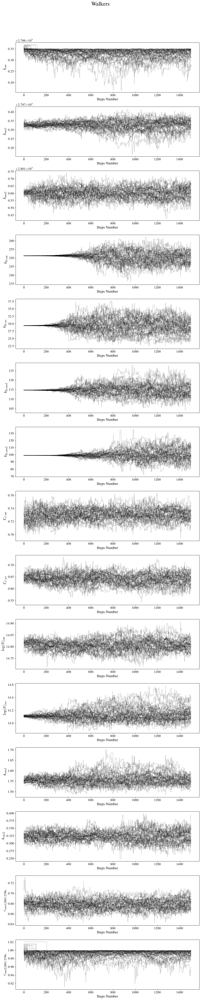

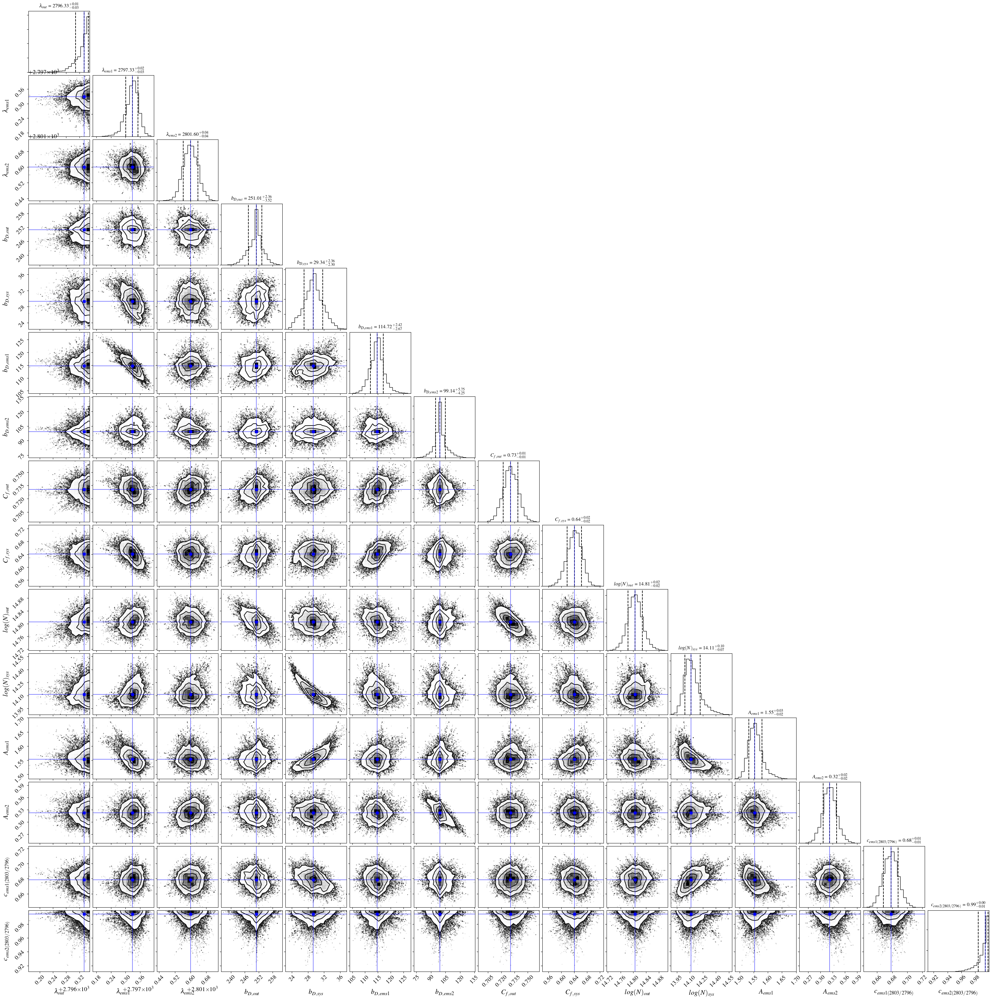

$\lambda_{out}  = 2796.3347   Angstrom
$\lambda_{ems1}  = 2797.3291   Angstrom
$\lambda_{ems2}  = 2801.5994   Angstrom
$b_{D, out}  = 251.0052   $km \ s^{-1}$
$b_{D, sys}  = 29.3369   $km \ s^{-1}$
$b_{D, ems1}  = 114.7207   $km \ s^{-1}$
$b_{D, ems2}  = 99.1448   $km \ s^{-1}$
$C_{f,out}  = 0.7305    
$C_{f,sys}  = 0.6414    
$log(N)_{out}  = 14.8055   $cm^{-2}$
$log(N)_{sys}  = 14.1142   $cm^{-2}$
$A_{ems1}  = 1.5537    
$A_{ems2}  = 0.3226    
$c_{ems1(2803/2796)}  = 0.6783    
$c_{ems2(2803/2796)}  = 0.9946    


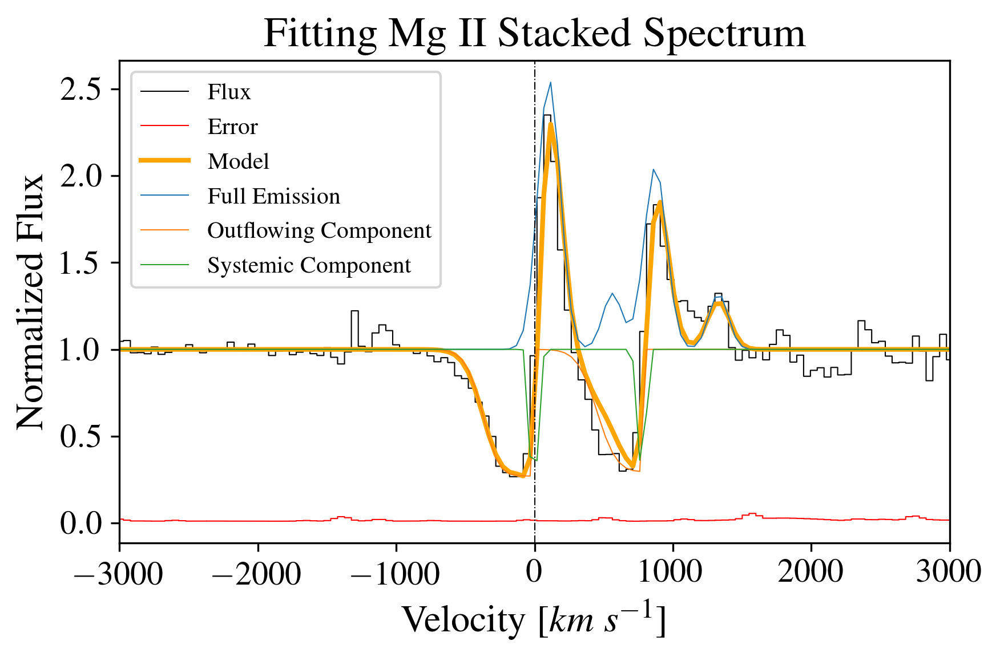

In [85]:
mg = ascii.read('/home/ahmed/Gdrive/astro/analysis/spectra/spectrum_MgII_stack_wl.dat')
mg

w = np.asarray(mg['wave'])
flux_norm = np.asarray(mg['flux_norm'])
flux_err_norm = np.asarray(mg['flux_err_norm'])

wave = u.airtovac(w)
wrest = wave/(1. + z)
#v,vabs,vems,tau1,tau2,tau3,tau4,c1,c2,c3,sig1,sig2,sig3
lam_cen = [2796.351, 2803.528, 2797.084, 2799.326, 2804.346, 2808.975]
vel = u.veldiff(wrest,lam_cen[0])

import musetools.modeling as m
import musetools.util as u
import importlib
importlib.reload(m)
importlib.reload(u)
from IPython.display import display, Math
samples_dir = '/home/ahmed/Gdrive/astro/analysis/emcee/MgII/samples/'
corner_dir = '/home/ahmed/Gdrive/astro/analysis/emcee/MgII/corner/'
walkers_dir = '/home/ahmed/Gdrive/astro/analysis/emcee/MgII/walkers/'
q_lim_out = np.where( (vel > -700.) & (vel < 0.0))
q_lim_ems1 = np.where( (vel > 0.0) & ( vel < 400.))
q_lim_ems2 = np.where( (vel > 300.) & ( vel < 900.))

wlim_out = wrest[q_lim_out]
wlim_ems1 = wrest[q_lim_ems1]
wlim_ems2 = wrest[q_lim_ems2]

#         vout0, vems1, vems2, b_D, b_D_sys, b_D_ems1, b_D_ems2, logN, logN_sys, A_1, A_2, c_ems1, c_ems2
p_names = ['$\lambda_{out}$', '$\lambda_{ems1}$', '$\lambda_{ems2}$', '$b_{D, out}$', '$b_{D, sys}$', '$b_{D, ems1}$', '$b_{D, ems2}$',\
           '$C_{f,out}$', '$C_{f,sys}$','$log(N)_{out}$', '$log(N)_{sys}$', '$A_{ems1}$', '$A_{ems2}$', '$c_{ems1(2803/2796)}$', '$c_{ems2(2803/2796)}$']
p_units = ['Angstrom', 'Angstrom', 'Angstrom', '$km \ s^{-1}$', '$km \ s^{-1}$', '$km \ s^{-1}$', '$km \ s^{-1}$', ' ', ' ','$cm^{-2}$', '$cm^{-2}$', ' ', ' ',  ' ', ' ']
#           lam_out,      l_ems1,        l_ems2, b_D,  b_Ds, b_De1, b_De2,  Co, Cs,  logN, logNs, A_1, A2, ce1, ce2
p0   = [      2795.,       2798.,         2800., 200., 50.0, 200.0, 100.0, 0.7, 0.6, 13.9,  13.9, 1.0, 0.5, 0.6, 0.6]
p_lw = [wlim_out[0],  lam_cen[0],  wlim_ems2[0], 100.,  0.0,  50.0,  50.0, 0.1, 0.1, 13.0,  13.0, 0.5, 0.0, 0.5, 0.5]
p_up = [ lam_cen[0],wlim_ems1[-1],wlim_ems2[-1], 600., 300., 600.0, 400.0, 1.0, 1.0, 16.0,  16.0, 6.0, 3.0, 1.0, 1.0]

names = ["MgII","stack_spec_wl_Cfvary"]


p_opt, up_sig, lw_sig = u.emcee_fit(m.model_MgII_wave_Cf, wrest, flux_norm, flux_err_norm, p0, p_lw, p_up, p_names, names, samples_dir, walkers_dir, corner_dir, plot=True, write=True)

for i in range(len(p_opt)):
    #display(Math(r' '+p_names[i]+': {} '+p_units[i]+' '.format(round(p_opt[i], 4))))
    print(p_names[i][0:-1],' =', round(p_opt[i],4),' ', p_units[i])

F_conv, F, F_out, F_sys, F_ems, F_out0, F_out1, F_ems1, F_ems2, F_ems11, F_ems12, F_ems21, F_ems22 = m.model_MgII_wave_Cf_comps(wrest, *p_opt)


lw = 0.5
vlim = [-3000., 3000.]
plt.close()
fig = plt.figure(1, figsize=(6,4), dpi=300)
ax = fig.add_subplot(111)
ax.step(vel, flux_norm, 'k-', lw=lw, label='Flux')
ax.step(vel, flux_err_norm, 'r-', lw=lw, label='Error')
ax.plot(vel, F_conv, c='orange', lw=2.0, label='Model')
#ax.plot(vel, F, lw = lw, label='Unconvolved Model')
ax.plot(vel, F_ems, lw=lw, label='Full Emission')
#ax.plot(vel, F_ems1, lw=lw, label='Emission1')
#ax.plot(vel, F_ems2, lw=lw, label='Emission2')
ax.plot(vel, F_out, lw=lw, label='Outflowing Component')
ax.plot(vel, F_sys, lw=lw, label='Systemic Component')
ax.set_xlabel(r'Velocity [$km \ s^{-1}$]')
ax.set_ylabel('Normalized Flux')
ax.set_xlim(vlim)
ax.set_title('Fitting Mg II Stacked Spectrum')
ax.legend(loc=2, fontsize='small')
ax.axvline(x=0.0, c='k', lw=lw, ls='-.')
fig.tight_layout()
plt.show()